In [32]:
#####################################################
# Goal of this code is to check KW in nudging experiments
# 2024.6.13
# Mu-Ting Chien
##############################################

In [33]:
import os
import sys
sys.path.append('/glade/work/muting/function/')
import KW_diagnostics as KW
import mjo_mean_state_diagnostics as MJO
import create_my_colormap as mycolor
RWB = mycolor.red_white_blue()
from sklearn import linear_model # for caclulating KW composite lag-lon precip
import cmaps

from netCDF4 import Dataset
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.cm import get_cmap # for plotting KW composite vertical structure

In [34]:
dir_out            = '/glade/work/muting/KW/'
CASENAME_LIST2     = list(['SST_AQP3_Qobs_27_-4K',\
                          'SST_AQP3_Qobs_27',\
                          'SST_AQP3_Qobs_27_4K'])
CASENAME_SHORT_LIST = list(['-4K','CTL','4K'])

nudging_version = 3 #0 (diff variables for 30-minute nudging timescale) 
                    #1 (T for different levels) or 
                    #2 (Tlf for different strength, less than 12 hr) or 
                    #3 (Tlf for different strength, over 12 hr
                    #4 (diff variables for 12-h nudging timescale), similar to 0
                    #5 (diff variables for 1-day nudging timescale), similar to 0
                    #6 (qlf for different strength, over 12 hr
if nudging_version == 0 or nudging_version == 4 or nudging_version == 5:
    # Version 1: compare differnet nudging variables --> nudge T damp KWs, therefore we use nudge T in the following
    # note thaat the above title are all 30 minute nudging timescale, so I do not include that
    if nudging_version == 0:
        NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_qlf_30m','nudge_qbl_30m','nudge_uvbl_30m','nudge_Tlf_30m'])
        figdir_all  = dir_out+'figure/Post_general/Nudging/All_30m_nudge_timescale/'
        output_dir_all = dir_out+'output_data/Nudge_30m_timescale/'
    elif nudging_version == 4:
        NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_qlf_12h','nudge_qbl_12h','nudge_uvbl_12h','nudge_Tlf_12h'])
        figdir_all  = dir_out+'figure/Post_general/Nudging/All_12h_nudge_timescale/'
        output_dir_all = dir_out+'output_data/Nudge_12h_timescale/'
    elif nudging_version == 5:
        NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_qlf_1d','nudge_qbl_1d','nudge_uvbl_1d','nudge_Tlf_1d'])
        figdir_all  = dir_out+'figure/Post_general/Nudging/All_1d_nudge_timescale/'
        output_dir_all = dir_out+'output_data/Nudge_1d_timescale/'
    title       = list(['(a) No nudging','(b) q 850-700 hPa','(c) q 1000-850 hPa','(d) uv 1000-850 hPa','(e) T 850-700 hPa'])
    title_short = list(['(a) No nudging','(b) q 850-700',    '(c) q 1000-850',    '(d) uv 1000-850',    '(e) T 850-700'])
    title_noabc = list(['No nudge','qlf','qbl','uv bl','Tlf'])
    legend_list = list(['No nudge','Nudge qlf','Nudge qbl','Nudge uvbl','Nudge Tlf'])

elif nudging_version == 1:
    # Version 2: compare nudging T for different levels --> nudge T at lower troposphere is the most effective
    NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_Tbl_30m','nudge_Tlf_30m','nudge_Tmf_30m','nudge_Tuf_30m',])
    title       = list(['(a) No nudging','(b) T 1000-900 hPa','(c) T 900-700 hPa','(d) T 450-600 hPa','(e) T 200-400 hPa'])
    title_short = list(['(a) No nudging','(b) T 1000-900',    '(c) T 900-700',    '(d) T 450-600',    '(e) T 200-400'])
    title_noabc = list(['No nudge','T 1000-900','T 900-700','T 450-600','T 200-400'])
    legend_list = title_noabc
    figdir_all  = dir_out+'figure/Post_general/Nudging/Nudge_T_diff_plev/'
    output_dir_all = dir_out+'output_data/Nudge_T_diff_plev/'
elif nudging_version == 2:
    # Version 3: compare different nudging strength for nudge T at lower troposphere
    NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_Tlf_12h','nudge_Tlf_6h','nudge_Tlf_3h','nudge_Tlf_30m'])
    title       = list(['(a) No nudging','(b) Tlf 12h','(c) Tlf 6h','(d) Tlf 3h','(e) Tlf 30m'])
    title_short = title
    title_noabc = list(['No nudge','Tlf 12h','Tlf 6h','Tlf 3h','Tlf 30m'])
    legend_list = title_noabc
    # The below includes 1 hr, while the above includes 6 hr
    #NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_Tlf_30m','nudge_Tlf_30m_half','nudge_Tlf_3h','nudge_Tlf_12h',]) 
    #title       = list(['(a) No nudging','(b) Nudge Tlf 12h','(c) Nudge Tlf 3h','(d) Nudge Tlf 1h','(e) Nudge Tlf 30m'])
    #title_noabc = list(['No nudge','Tlf 12h','Tlf 3h','Tlf 1h','Tlf 30m'])
    title_short = title
    figdir_all  = dir_out+'figure/Post_general/Nudging/Nudge_Tlf_diff_strength/'
    output_dir_all = dir_out+'output_data/Nudge_Tlf_diff_strength/'
elif nudging_version == 3:
    # Version 3: compare different nudging strength for nudge T at lower troposphere
    NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_Tlf_4d','nudge_Tlf_2d','nudge_Tlf_1d','nudge_Tlf_12h'])
    title       = list(['(a) No nudging','(b) Tlf 4d','(c) Tlf 2d','(d) Tlf 1d','(e) Tlf 12h'])
    title_short = title
    title_noabc = list(['No nudge','Tlf 4d','Tlf 2d','Tlf 1d','Tlf 12h'])
    legend_list = title_noabc
    title_short = title
    figdir_all  = dir_out+'figure/Post_general/Nudging/Nudge_Tlf_diff_strength_above_12h/'
    output_dir_all = dir_out+'output_data/Nudge_Tlf_diff_strength_above_12h/'  
elif nudging_version == 6:
    # Version 3: compare different nudging strength for nudge q at lower troposphere
    NUDGE_LIST  = list(['3h_20y_CLUBB_new','nudge_qlf_4d','nudge_qlf_2d','nudge_qlf_1d','nudge_qlf_12h'])
    title       = list(['(a) No nudging','(b) qlf 4d','(c) qlf 2d','(d) qlf 1d','(e) qlf 12h'])
    title_short = title
    title_noabc = list(['No nudge','qlf 4d','qlf 2d','qlf 1d','qlf 12h'])
    legend_list = title_noabc
    title_short = title
    figdir_all  = dir_out+'figure/Post_general/Nudging/Nudge_qlf_diff_strength_above_12h/'
    output_dir_all = dir_out+'output_data/Nudge_qlf_diff_strength_above_12h/'
    
n_nudge = np.size(NUDGE_LIST)

icase          = 0 # 0-2 (-4k, CTL, +4K)
os.makedirs(figdir_all, exist_ok=True)
os.makedirs(output_dir_all, exist_ok=True)
s2d = 86400
nlag = 10*8 #10 day when calculating kw composite precip at (lon, lag)

iyr_min = 2
iyr_max = 2 #2-4
nyr = iyr_max-iyr_min+1
yr = np.arange(0,nyr)+1

# Constant used for KW phase composite
pi  = np.pi
PI = '\u03C0'
bin_simple = np.arange(-pi,pi+1/4*pi,1/4*pi)
bin_simple2 = np.arange(-pi,pi+1/2*pi,1/2*pi)

# Parameters for coh^2 figure
s2d = 86400
g  = 9.8
re = 6371*1000 #earth radius (m)

color = list(['k','b','g','y','r'])

In [35]:
# KW band for each simulation
if icase == 0: #-4K
    freq_min = 1/8
    freq_max = 1/2.5
    wnum_min = 1
    wnum_max = 15
    h_min    = 8
    h_max    = 50

#####################
# Dispersion curve and CCKW band
d = np.array([4,8])#([3,6]) # mark 3, 6, 20 day in WK1999
dname = list(['4d','8d'])#(['3d','6d'])
he = np.array([8,25,50]) 
hname = list(['8m','25m','50m'])
he_all = np.array([8, 12, 25, 50, 150])

# dispersion curve
xloc = np.array([12,12,4.9])
yloc = np.array([0.29,0.47,0.47])
cp = (g*he_all)**0.5
zwnum_goal = 0.5/s2d/cp*2*np.pi*re
# CCKW band
s_min = (g*he[0])**0.5/(2*np.pi*re)*s2d #slope of he = 8m
s_max = (g*he[2])**0.5/(2*np.pi*re)*s2d #slope of he = 90m
kw_tmax_list = np.array([8,7,4])
kw_tmax = kw_tmax_list[icase]
fmax = np.array([0.4,1/2.25,0.5])
kw_x = np.array([1/kw_tmax/s_max, 1/kw_tmax/s_min,     15,  15, fmax[icase]/s_max, 1/kw_tmax/s_max])
kw_y = np.array([1/kw_tmax,             1/kw_tmax,  15*s_min, fmax[icase],      fmax[icase],  1/kw_tmax])

In [11]:
#########################
# Load climatological variables (mean state general circulation)
####################
for inug in range(1,n_nudge):
    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'
    data    = np.load(output_dir+'mean_state_Tuvwq_all.npz')
    plev    = data['plev']
    lat     = data['lat']
    nlev    = np.size(plev)
    nlat    = np.size(lat)
    if inug == 0:
        um_all = np.empty([nlat, nlev, n_nudge])
        Tm_all = np.empty([nlat, nlev, n_nudge])
        vm_all = np.empty([nlat, nlev, n_nudge])
        wm_all = np.empty([nlat, nlev, n_nudge])
        qm_all = np.empty([nlat, nlev, n_nudge])
    um_all[:,:,inug] = data['um']
    Tm_all[:,:,inug] = data['Tm']-273.15
    vm_all[:,:,inug] = data['vm']
    wm_all[:,:,inug] = data['wm']
    qm_all[:,:,inug] = data['qm']            

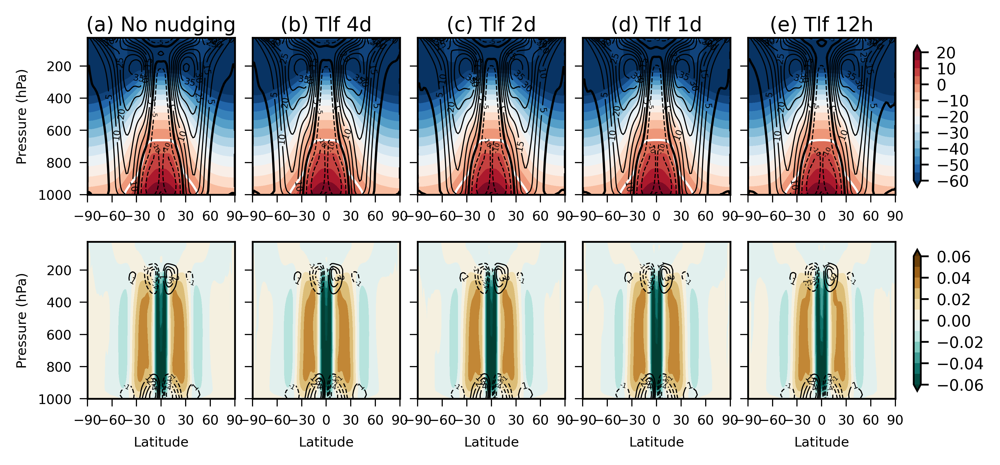

In [13]:
################################################
# Fig. 1: Plot zonal mean u, T, q, rh, v, w (lat, plev) for all nudging exps, execute this!!!!
##################################################
V1name = list(['Tm','wm'])
V2name = list(['um','vm'])
cmap = list(['RdBu_r','BrBG_r'])
cn_format = list(['%d','%d'])

cmin = np.array([-60, -0.06,5]) 
cmax = np.array([25, 0.07,105])
cint = np.array([5, 0.01])
ctmin = np.array([-60,-0.06]) 
ctmax = np.array([30,0.08]) 
ctint = np.array([10,0.02]) 
cn_min = np.array([-20, -6])
cn_max = np.array([55,7])
cn_int = np.array([5  ,1])
x, y = np.meshgrid(lat,plev)

fig_name = 'fig1_Twuv_zm_qbl.png'
fig,axes = plt.subplots(2,n_nudge,figsize=(6.5, 3),dpi=600)
plt.subplots_adjust(left=0.1, right=0.98,top=0.9,bottom=0.15,hspace=0.3, wspace=0.12)
#plt.rcParams.update({'font.size': 7})
plt.rcParams.update({'font.size': 6})
for iplt in range(0,2): #(T_u, rh_vw)
    for inug in range(0,n_nudge):
        plt.subplot(2,n_nudge,iplt*n_nudge+inug+1)
        if iplt == 0:
            plt.title(title_short[inug], pad=3, loc='center',fontsize=9)
        colormap = cmap[iplt]
        clev  = np.arange(cmin[iplt],cmax[iplt],cint[iplt])
        if iplt == 0:
            ticks = np.arange(-60,30,10)
        else:
            ticks = np.array([-0.06,-0.04,-0.02,0,0.02,0.04,0.06])
        tmp = globals() [V1name[iplt]+'_all']
        V1 = tmp[:,:,inug].T
        cf = plt.contourf(x, y, V1, levels = clev, cmap=colormap, zorder=2, alpha=0.99,extend = 'both')
        if iplt == 0:
            cr0_V1 = plt.contour(x,y,V1,levels=0,colors='w',linestyles='solid',linewidths=1)
        clevp = np.arange(cn_int[iplt],cn_max[iplt],cn_int[iplt])
        clevn = np.arange(cn_min[iplt],0,cn_int[iplt])
        tmp = globals() [V2name[iplt]+'_all']
        V2  = tmp[:,:,inug].T
        if iplt == 0 or iplt == 1:
            crp = plt.contour(x, y, V2, levels=clevp, colors='k', linewidths=0.5)
            plt.clabel(crp, inline=1, fontsize=4, fmt=cn_format[iplt],inline_spacing=8)
            crn = plt.contour(x, y, V2, levels=clevn, colors='k', linestyles='dashed', linewidths=0.5)
            plt.clabel(crn, inline=1, fontsize=3, fmt=cn_format[iplt],inline_spacing=8)
        if iplt == 1:
            plt.xlabel('Latitude')
        if iplt == 0:
            cr0_V2 = plt.contour(x,y,V2,levels=0,colors='k',linestyles='solid',linewidths=1)
        ax = plt.gca()
        if inug == 0:
            ax.tick_params(width=0.5,bottom=True, top=False, left=True, right=False)
            ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False)
            plt.ylabel('Pressure (hPa)')
        else:
            ax.tick_params(width=0.5,bottom=True, top=False, left=True, right=False)
            ax.tick_params(labelbottom=True, labeltop=False, labelleft=False, labelright=False)            
        ax.tick_params(axis="both", direction="out")
        plt.gca().invert_yaxis()
        plt.xticks(np.arange(-90,120,30))
    cb = plt.colorbar(cf, ax=axes[iplt,:], orientation = 'vertical',shrink=0.9,fraction=0.1, \
                          pad=0.02,aspect=20*1) 
    cb.ax.tick_params(labelsize=7)
    cb.set_ticks(ticks)  
plt.savefig(figdir_all+fig_name,format='png', dpi=600)
plt.show()
plt.close()

In [ ]:
############################################
# 0-2. Plot the mean state temperature profile in the tropics
############################################
Tm_10SN_all = MJO.

font = 8
plot_T = 1
fig_name = 'Tropic_mean_T.png'
fig,axes = plt.subplots(1,1,figsize=(3.2, 2.4),dpi=600)
plt.subplots_adjust(left=0.22,right=0.8,top=0.9,bottom=0.1,wspace=0.2,hspace=0.3)
plt.rcParams.update({'font.size': font})
zero = np.zeros([nlev])
#for inug in range(0,n_nudge):
if plot_T == 1:
    plt.subplot(1,1,1)
    ax = plt.gca()
    plt.plot(Tm_all[:,0], plev, 'k')
    plt.plot(Tm_all[:,1], plev, 'b--')
    plt.plot(Tm_all[:,2], plev, 'g:')
    plt.plot(Tm_all[:,3], plev, 'y:')
    plt.plot(Tm_all[:,4], plev, 'r:')
    #plt.xticks(np.arange(-0.3,0.6,0.3))
    plt.plot(zero, plev,'k:')
    plt.tick_params(bottom=True,top=False,left=True,right=False)
    plt.ylim([np.min(plev), np.max(plev)]) 
    plt.yticks(np.arange(100,1000,100))
    plt.gca().invert_yaxis()
    plt.title('Mean T', pad=3, loc='center',fontsize=9)
    plt.ylabel('Pressure (hPa)')
    plt.tick_params(labelbottom=True,labeltop=False,labelleft=True,labelright=False)

plt.savefig(figdir_all+fig_name,format='png', dpi=600)
plt.show()
plt.close()

In [21]:
####################################
# 0. Calculate zonal mean precip (Supplementary)
##########################################
precip_saved_zm = 1
if precip_saved_zm == 1:
    for inug in range(0,n_nudge):
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
    
        data = np.load(output_dir+'precip_zm.npz')
        lat   = data['lat']
        nlat  = np.size(lat)
        n_nudge = np.size(NUDGE_LIST)

        if inug == 0:
            pr_zm_all = np.empty([nlat, n_nudge])
        pr_zm_all[:,inug] = data['pr_zm']

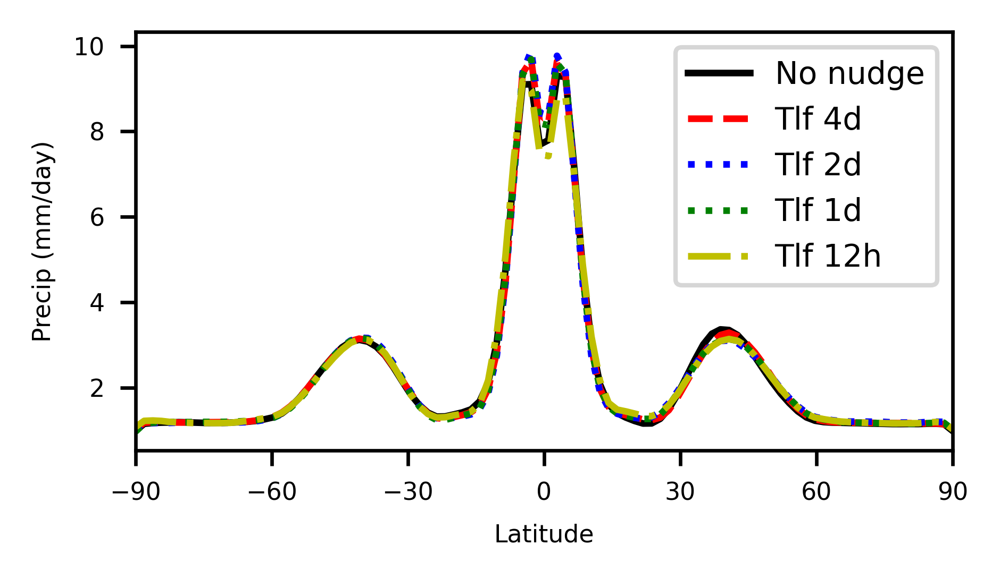

In [22]:
###############################
# Plot zonal mean precip (all exps)
##############################
fig_name = 'fig2_pr_zm.png'
fig = plt.subplots(1,1,figsize=(3.2, 1.8),dpi=600)
plt.subplots_adjust(left=0.15,right=0.95,top=0.95,bottom=0.22)
plt.rcParams.update({'font.size': 7})
#
plt.subplot(1,1,1)
plt.plot(lat, pr_zm_all[:,0], 'k')
plt.plot(lat, pr_zm_all[:,1], 'r--')
plt.plot(lat, pr_zm_all[:,2], 'b:')
plt.plot(lat, pr_zm_all[:,3], 'g:')
plt.plot(lat, pr_zm_all[:,4], 'y-.')
ax = plt.gca()
plt.legend(legend_list)
plt.xlim([-90,90])
plt.xticks(np.arange(-90,120,30))
plt.xlabel('Latitude')
plt.ylabel('Precip (mm/day)')
plt.yticks(np.arange(2,12,2))
plt.savefig(figdir_all+fig_name,format='png', dpi=600)
plt.show()
plt.close()

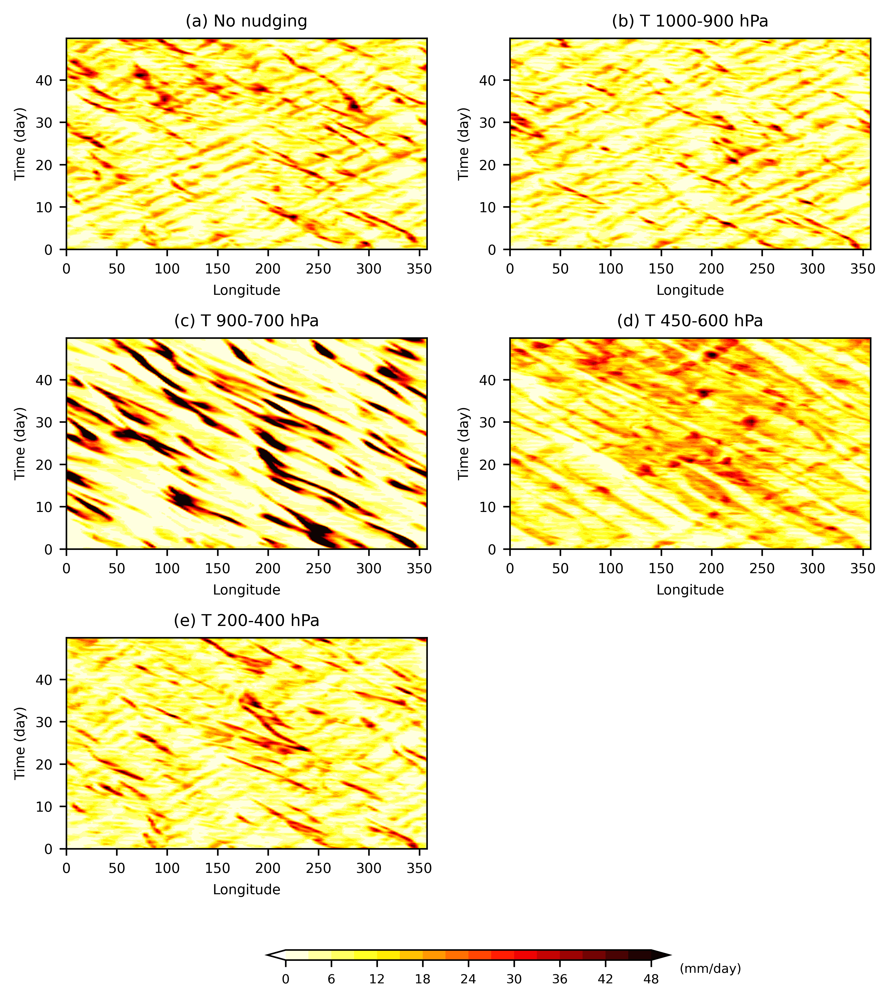

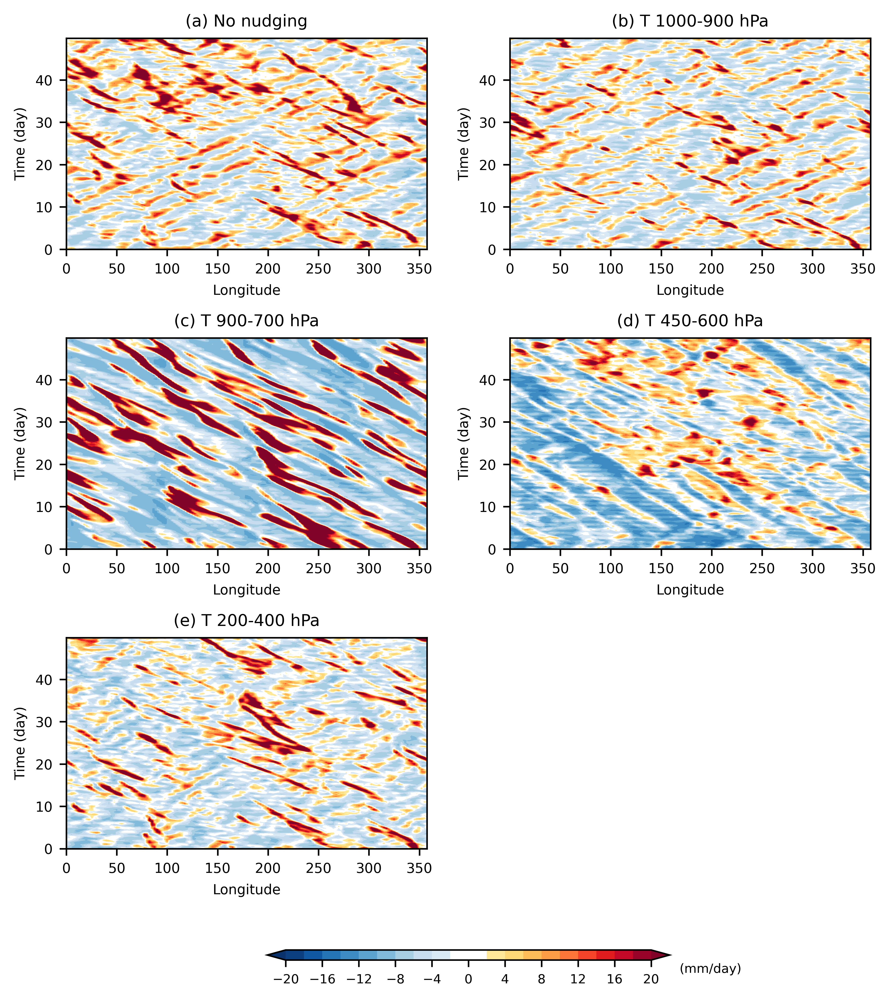

In [30]:
# Plot precip hovmoller at the equator
for plot_raw_ano in range(0,2):
    for inug in range(0,n_nudge):
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
        data = np.load(output_dir+'precip.npz')

        # Make sure all exp start from the same day
        if inug == 0:
            tmin = 8742-8525
        else:
            tmin = 0
        
        precip = data['precip'][tmin:,:,:]
        pr_ano = data['pr_ano'][tmin:,:,:]
        time   = data['time'][:-tmin]
        lon    = data['lon']
        lat    = data['lat']
        nlat   = np.size(lat)
        
        pr_equator = np.mean(precip[:,int(nlat/2-1):int(nlat/2+1),:],1)
        pr_ano_equator = np.mean(pr_ano[:,int(nlat/2-1):int(nlat/2+1),:],1)
        day_max = 50 # how many days to plot
        t = np.arange(0,8*day_max)
        time_day = t*3/24
        clev = np.arange(0,51,3)
        cticks = np.arange(0,54,6)
        clev_ano = np.arange(-20,22,2)
        cticks_ano = np.arange(-20,24,4)
        lont, tlon = np.meshgrid(lon, time_day[t])
    
        if inug == 0:
            #fig,axes = plt.subplots(2,2,figsize=(6.5, 6.5),dpi=600)
            fig,axes = plt.subplots(3,2,figsize=(6.5, 8),dpi=600)
            plt.rcParams.update({'font.size': 7})
            plt.subplots_adjust(left=0.1,right=0.98,top=0.95,bottom=0.05,wspace = 0.23, hspace = 0.42)
        if plot_raw_ano == 0:
            figname = 'fig4_lon_t_hovmoller_pr.png'
            #ax = plt.subplot(2,2,inug+1)
            ax = plt.subplot(3,2,inug+1)
            cf = plt.contourf(lont, tlon, pr_equator[t,:], levels = clev, cmap='hot_r', zorder=2, alpha=0.99,extend = 'both' )
        else:
            figname = 'fig4_lon_t_hovmoller_pr_ano.png'
            #ax = plt.subplot(2,2,inug+1)
            ax = plt.subplot(3,2,inug+1)
            cf = plt.contourf(lont, tlon, pr_ano_equator[t,:], levels = clev_ano, cmap=get_cmap(RWB), zorder=2, alpha=0.99,extend = 'both' )        
        plt.title(title[inug])
        plt.xlabel('Longitude',fontsize=7)
        plt.ylabel('Time (day)',fontsize=7)
    cb = fig.colorbar(cf,ax=axes,orientation='horizontal',shrink=.5,fraction=0.1, pad=0.1,aspect=40*1)
    cb.ax.tick_params(labelsize=6.5)
    if plot_raw_ano == 0:
        cb.set_ticks(cticks)
    else:
        cb.set_ticks(cticks_ano)   

    ax.text(1.7, -0.6, '(mm/day)',\
                verticalalignment='bottom', horizontalalignment='left',transform=ax.transAxes,\
                color='k', fontsize=6.5)

    for ax in axes[2:,1]:
        ax.remove()
        
    plt.savefig(figdir_all+figname,format='png', dpi=600)
    plt.show()
    plt.close()

/glade/u/ssg/ch/usr/jupyterhub/envs/cmip6-201910a/lib/python3.7/site-packages/ipykernel_launcher.py:19: ComplexWarning: Casting complex values to real discards the imaginary part
/glade/u/ssg/ch/usr/jupyterhub/envs/cmip6-201910a/lib/python3.7/site-packages/ipykernel_launcher.py:20: ComplexWarning: Casting complex values to real discards the imaginary part


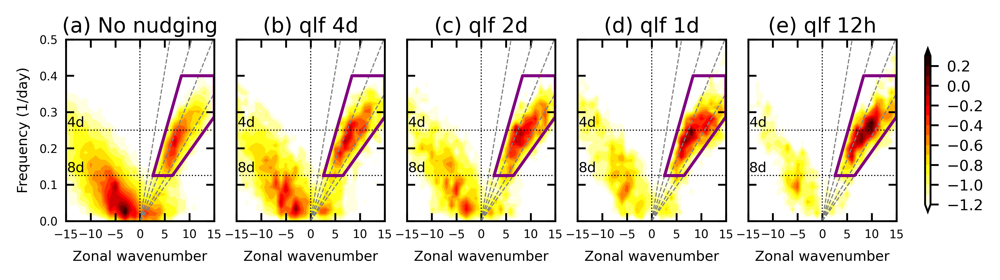

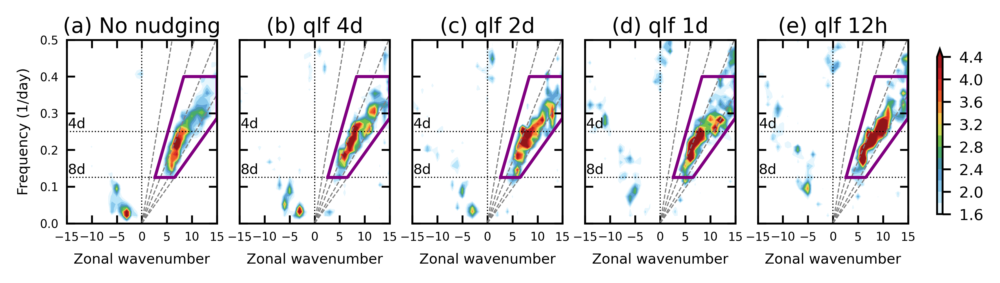

In [13]:
#########################################################
# Load raw and normalized power spectrum of precip and plot power spectrum
##########################################################
for inug in range(0,n_nudge):

    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'
    data     = np.load(output_dir+'pr_wavenum_freq.npz')

    if inug == 0:
        tmp = data['power_pr']
        n0  = np.size(tmp, 0)
        n1  = np.size(tmp, 1)
        power_pr_all = np.empty([n0, n1, n_nudge])
        r_sym_all    = np.empty([n0, n1, n_nudge])
        x = data['x']
        y = data['y']
        
    power_pr_all[:,:,inug] = data['power_pr']
    r_sym_all[:,:,inug]    = data['r_sym']


#################################
# Plot power spectrum
###############################
vname = list(['power_pr_all','r_sym_all'])
axid = np.array([0,1,2,3,4]).astype('int')
xid = np.array([0,0,0,0,0]).astype('int')
yid = np.array([0,1,2,3,4]).astype('int')
extend_list = list(['both','max'])

for iplt in range(0,np.size(vname)):# plot raw or normalized power spectrum
    
    figname = 'fig5_'+vname[iplt]+'.png'
    v_cf = globals() [vname[iplt]]

    if iplt == 0:
        clev = np.arange(-1.2,0.4,0.1)
        cticks = np.arange(-1.2,0.4,0.2)
    elif iplt == 1:
        clev = np.arange(1.6,4.6,0.2)
        cticks = np.arange(1.6,4.8,0.4)    
    
    fig,ax = plt.subplots(1,5,figsize=(6.5, 1.6),dpi=600)
    plt.subplots_adjust(left=0.1,right=0.98,top=0.9,bottom=0.22,wspace=0.15)
    plt.rcParams.update({'font.size': 5.5})
    for v in range(0,5):

        ax[yid[v]] = plt.subplot(1,n_nudge,axid[v]+1)
            
        # plot coh2 and sin, cos
        if iplt == 0:
            cf = plt.contourf(x, y, np.log10(v_cf[:,:,v]), cmap='hot_r', levels = clev, extend=extend_list[iplt])
        else:
            cf = plt.contourf(x, y, v_cf[:,:,v], cmap=cmaps.WhiteBlueGreenYellowRed, levels = clev, extend=extend_list[iplt])
        
        # Mark 3, 6, 20 day period:
        for dd in range(0,np.size(d)):
            plt.plot([-15,15], [1/d[dd],1/d[dd]], 'k',linewidth=0.5, linestyle=':')#'dashed')
            plt.text(-14.8,1/d[dd]+0.01,dname[dd], fontsize=6)
        # Mark CCKW dispersion relationship:
        for hh in range(0,np.size(he_all)):
            plt.plot([0,zwnum_goal[hh]],[0,0.5],'grey',linewidth=0.5,linestyle='dashed')#,linestyle='dashed')#linestyle=':')#linestyle=(0,(5,5)))            
        # Mark zwnum == 0:
        plt.plot([0,0],[0,0.5],'k',linewidth=0.5,linestyle=':')#'dashed')
        # Mark CCKW band:
        # y=s*x
        for kk in range(0,np.size(kw_x)):
            plt.plot(kw_x,kw_y,'purple',linewidth=1.2,linestyle='solid')
        
        plt.title(title_short[v], pad=3, loc='center',fontsize=9)
        if v == 0:
            plt.ylabel('Frequency (1/day)',fontsize=6)
        plt.xlabel('Zonal wavenumber',fontsize=6)
        plt.axis([-15,15,0,0.5])
        plt.xticks([-15,-10,-5,0,5,10,15],fontsize=5)
        plt.yticks(np.arange(0,0.6,0.1),fontsize=5)
        plt.tick_params(bottom=True,top=True,left=True,right=True)
        if v == 0:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=True,labelright=False)
        else:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        plt.tick_params(direction="in")
        
    cb = fig.colorbar(cf,ax=ax[:],orientation = 'vertical',shrink=.9,\
                    fraction=0.1, aspect=30, pad=0.03)
    cb.ax.tick_params(labelsize=6.5)
    cb.set_ticks(cticks)  
    plt.savefig(figdir_all+figname,format='png', dpi=600)
    plt.show()
    plt.close()                                

In [14]:
save_kw_precip = 1

if save_kw_precip == 1:

    # Load kw composite precip for all nudging exps
    for inug in range(0,n_nudge):
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
        #
        data       = np.load(output_dir+'precip_kw.npz')
        phase      = data['phase_bin']
        nphase     = np.size(phase)
        if inug == 0:
            pr_kw_all  = np.empty([nphase, n_nudge])
            kw_amp_all = np.empty([n_nudge])
        pr_kw_all[:,inug] = data['pr_kw']
        kw_amp_all[inug]  = (np.max(pr_kw_all[:,inug])-np.min(pr_kw_all[:,inug]))/2  
    print('KW amplitude:',kw_amp_all)

    np.savez(output_dir_all+'kw_pr_amplitude.npz', pr_kw_all=pr_kw_all, phase=phase, kw_amp_all=kw_amp_all)

else:
    # load KW composite precip and kw amplitude
    data = np.load(output_dir_all+'kw_pr_amplitude.npz')
    pr_kw_all = data['pr_kw_all']
    phase     = data['phase']
    kw_amp_all = data['kw_amp_all']

KW amplitude: [3.30064838 3.59942604 3.68498994 3.90137256 4.0269298 ]


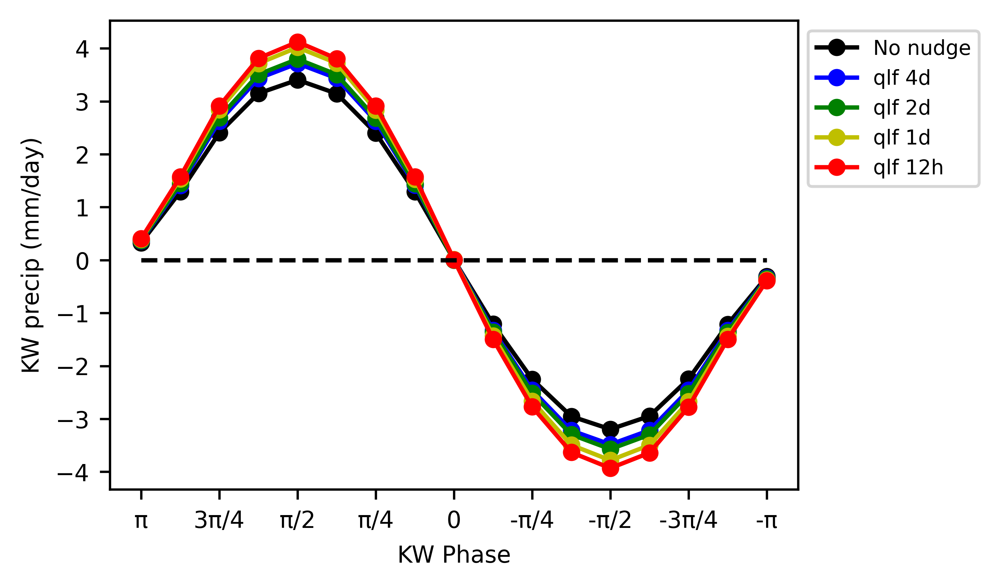

In [23]:
##############################
# Plot KW composite precip, all nudging experiments
###############################
plt.rcParams.update({'font.size': 8})
nph = np.size(phase)
zero = np.zeros([nph])
fig_name = 'fig3_KW_pr_1cyc.png'
fig = plt.subplots(1,1,figsize=(5.5, 3),dpi=600)
plt.subplots_adjust(left=0.2,right=0.8,top=0.95,bottom=0.2)
plt.rcParams.update({'font.size': 8})
plt.plot(phase, pr_kw_all[:,0],color='k',marker='o',markersize=5)
plt.plot(phase, pr_kw_all[:,1],color='b',marker='o',markersize=5)
plt.plot(phase, pr_kw_all[:,2],color='g',marker='o',markersize=5)
plt.plot(phase, pr_kw_all[:,3],color='y',marker='o',markersize=5)
plt.plot(phase, pr_kw_all[:,4],color='r',marker='o',markersize=5)
plt.plot(phase, zero,'k--')
ax = plt.gca()
ax.legend(legend_list, bbox_to_anchor=(1, 1), loc='upper left',fontsize=7)
plt.xticks(bin_simple,(PI,'3'+PI+'/4',PI+'/2',PI+'/4','0','-'+PI+'/4','-'+PI+'/2','-3'+PI+'/4','-'+PI))
plt.xlabel('KW Phase')
#plt.yticks(np.arange(-3,4,1))
plt.yticks(np.arange(-4,5,1))
plt.ylabel('KW precip (mm/day)')
plt.savefig(figdir_all+fig_name,format='png', dpi=600)
plt.show()
plt.close()

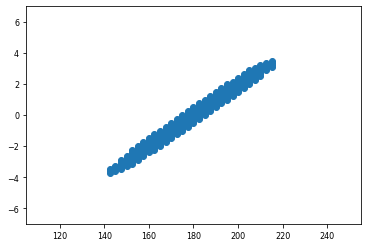

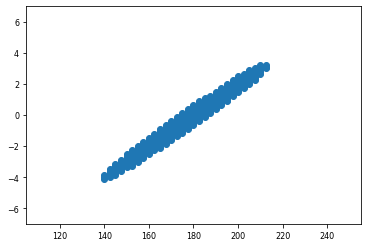

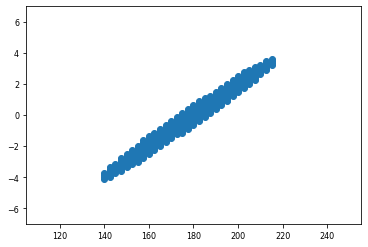

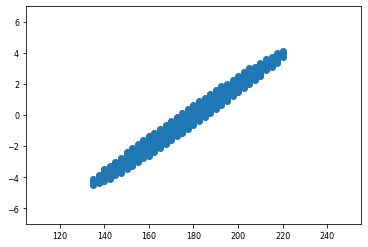

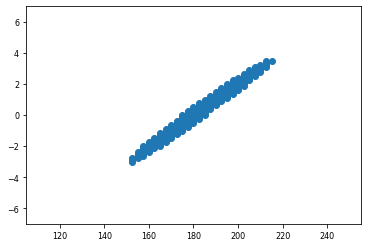

Cp ave: [12.88473631 12.6049723  12.74215821 12.73668129 12.19083368]


In [20]:
#########################################
# Calculate lag-lon regression of KW precip anomaly
##################################################
for inug in range(0,n_nudge):
    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'
    data = np.load(output_dir+'precip_kw.npz')
    time = data['time_pr'] 
    lon  = data['lon']
    nlon = np.size(lon)
    nt   = np.size(time)
    
    # find reference longitude
    lon_ref = 180
    ilon = np.argwhere(lon==lon_ref).squeeze()
    phase_kw = data['phase_correct'][:,ilon] #(time, lon)
    pr_kw_ano = data['KW_filtered_pr']
    
    # Now that every variable is (time, lon)
    # find time with maximum precipitaiton
    it_max = np.argwhere(phase_kw==-pi/2).squeeze()    
    it_max = np.where( ((it_max<=nlag)|(it_max>=nt-nlag)),np.nan,it_max ) 
    it_max = np.delete(it_max, np.isnan(it_max)==1)
    
    it_max_new = np.empty(np.size(it_max),dtype='int')
    for i in range(0,np.size(it_max)):
        it_max_new[i] = int(it_max[i])
                   
    # composite pr_ano, pr_kw
    if inug == 0:
    	pr_kw_comp_all  = np.empty([nlag*2+1, nlon, n_nudge])
 
    pr_kw_comp_all[nlag,:,inug]   = np.nanmean( pr_kw_ano[it_max_new, :],0)
    for ilag in range(1,nlag+1):        
        pr_kw_comp_all[nlag-ilag,:,inug] = np.nanmean(pr_kw_ano[it_max_new-ilag, :],0)
        pr_kw_comp_all[nlag+ilag,:,inug] = np.nanmean(pr_kw_ano[it_max_new+ilag, :],0)

tlag = np.arange(-nlag,nlag+1,1)/8
lont, tlon = np.meshgrid(lon, tlag)

# variable dimension: 
#   pr_kw_comp_all(nlag, nt, n_nudge)
#   lont(nlag, nt)
#   tlon(nlag, nt)
np.savez(output_dir_all+'kw_composite_lag_lon_prkw.npz', pr_kw_comp_all=pr_kw_comp_all, \
         lont=lont, tlon=tlon, tlag=tlag, lon=lon)

###############################################
# Find average phase speed

# Only save the data that is bigger than 2
pr_strong = np.empty([nlag*2+1, nlon, n_nudge])
if nudging_version == 0 or nudging_version == 4:
    pr_strong[:,:,:-1] = np.where( pr_kw_comp_all[:,:,:-1]>=1.9, pr_kw_comp_all[:,:,:-1], np.nan)
    pr_strong[:,:,-1]  = np.where( pr_kw_comp_all[:,:,-1]>=0.5, pr_kw_comp_all[:,:,-1], np.nan)
elif nudging_version == 1:
    pr_strong[:,:,:2]  = np.where( pr_kw_comp_all[:,:,:2]>=1.9, pr_kw_comp_all[:,:,:2], np.nan)
    pr_strong[:,:,2]  = np.where( pr_kw_comp_all[:,:,2]>=0.5, pr_kw_comp_all[:,:,2], np.nan)
    pr_strong[:,:,3:]  = np.where( pr_kw_comp_all[:,:,3:]>=1.5, pr_kw_comp_all[:,:,3:], np.nan)
elif nudging_version == 2:
    pr_strong[:,:,0]  = np.where( pr_kw_comp_all[:,:,0]>=1.9, pr_kw_comp_all[:,:,0], np.nan)
    pr_strong[:,:,1:]  = np.where( pr_kw_comp_all[:,:,1:]>=0.5, pr_kw_comp_all[:,:,1:], np.nan)
elif nudging_version == 3:
    pr_strong[:,:,0]  = np.where( pr_kw_comp_all[:,:,0]>=1.9, pr_kw_comp_all[:,:,0], np.nan)
    pr_strong[:,:,1:]  = np.where( pr_kw_comp_all[:,:,1:]>=1.5, pr_kw_comp_all[:,:,1:], np.nan)
elif nudging_version == 6:
    pr_strong[:,:,:-1] = np.where( pr_kw_comp_all[:,:,:-1]>=1.9, pr_kw_comp_all[:,:,:-1], np.nan)
    pr_strong[:,:,-1]  = np.where( pr_kw_comp_all[:,:,-1]>=2.7, pr_kw_comp_all[:,:,-1], np.nan)
    
Cp_ave = np.empty([n_nudge])
for inug in range(0,n_nudge):
    istrong = np.argwhere(np.isnan(pr_strong[:,:,inug])==0).squeeze()
    itlag_strong = istrong[:,0] 
    ilon_strong  = istrong[:,1]

    plt.scatter(lon[ilon_strong], tlag[itlag_strong])
    plt.xlim([105,255])
    plt.ylim([-7,7])
    plt.show()
    
    # find regression slope
    regr = linear_model.LinearRegression()
    y = lon[ilon_strong]
    x = np.array( [ tlag[itlag_strong] ] ).transpose()
    regr.fit(x,y)
    
    # ynew = b0 + b1*x 
    b0 = regr.intercept_
    b1 = regr.coef_[0]
    if inug == 0:
        Cp_ave_all = np.empty([n_nudge])
    Cp_ave_all[inug] = b1*111*1000/(24*60*60) #m/s

print('Cp ave:',Cp_ave_all)
np.savez(output_dir_all+'kw_phase_speed_from_hovmoller.npz', Cp_ave_all=Cp_ave_all)

In [21]:
# Use KW composite precip (Hovmoller) to find average KW wavenumber and frequency for each nudging exp
data = np.load(output_dir_all+'kw_composite_lag_lon_prkw.npz')
pr_kw_comp_all = data['pr_kw_comp_all']
lon  = data['lon'][:]
tlag = data['tlag'][:]
lont = data['lont'][:]
tlon = data['tlon'][:]

# Find lag day 0
ilag_0 = np.argwhere(tlag==0).squeeze()

# Find longitude = 180
ilon_180 = np.argwhere(lon==180).squeeze()

for inug in range(0,n_nudge):
    if inug == 0:
        zwnum_ave_all = np.empty([n_nudge])
        freq_ave_all  = np.empty([n_nudge])
    
    #################
    # 1. Find zwnum ave
    pr_kw_lag0 = pr_kw_comp_all[ilag_0, :, inug]

    # find lon with minimum pr_kw_hovmoller
    ilon_min = np.argwhere(pr_kw_lag0 == np.min(pr_kw_lag0[:ilon_180])).squeeze()
    ilon_max = np.argwhere(pr_kw_lag0 == np.min(pr_kw_lag0[ilon_180:])).squeeze()
    
    # find zwnum_ave
    lon_min = lon[ilon_min]
    lon_max = lon[ilon_max]
    #print('lon_min, lon_max:',lon_min, lon_max)
    zwnum_ave_all[inug] = 360/(lon_max-lon_min)
    
    #############################
    # 2. Find freq ave
    pr_kw_lon180 = pr_kw_comp_all[:, ilon_180, inug]
    
    # find tlag with minimum pr_kw_hovmoller
    it_min = np.argwhere(pr_kw_lon180 == np.min(pr_kw_lon180[:ilag_0])).squeeze()
    it_max = np.argwhere(pr_kw_lon180 == np.min(pr_kw_lon180[ilag_0:])).squeeze()    
    
    # find freq_ave
    tlag_min = tlag[it_min]
    tlag_max = tlag[it_max]
    #print('tlag_min, tlag_max:',tlag_min, tlag_max)
    freq_ave_all[inug] = tlag_max-tlag_min

print('Averaged KW period:',freq_ave_all)
print('Averaged KW zonal wavenum:',zwnum_ave_all)
np.savez(output_dir_all+'kw_zwnum_freq_from_hovmoller.npz', freq_ave_all=freq_ave_all, zwnum_ave_all=zwnum_ave_all)

Averaged KW period: [3.75 3.75 3.75 3.75 3.75]
Averaged KW zonal wavenum: [10.28571429 10.28571429 10.28571429  9.6        10.28571429]


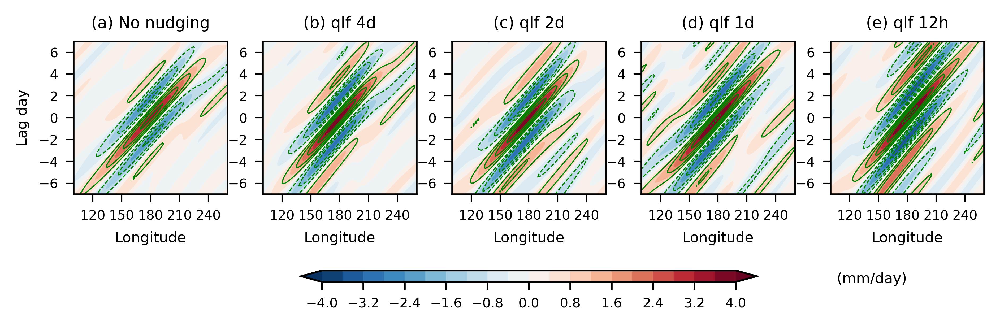

In [22]:
############################################
# Fig. 4: Plot precip hovmoller: kwpr (lag-lon)
##############################################
clev = np.arange(-4,4.4,0.4)
cticks = np.arange(-4,4.8,0.8)
CMAP = 'RdBu_r'
#
clev_pr_kw_p = np.arange(0.8,4.8,0.8)
clev_pr_kw_n = np.arange(-4,0,0.8)
font = 6.5

figname = 'fig4_lon_t_hovmoller_kwpr.png'
fig,axes = plt.subplots(1,n_nudge,figsize=(6.5, 2),dpi=600)
plt.rcParams.update({'font.size': 6})
for inug in range(0,n_nudge):
    ax = plt.subplot(1,n_nudge,inug+1)
    plt.subplots_adjust(left=0.1,right=0.98,top=0.9,bottom=0.1,wspace = 0.23)
    cf   = plt.contourf(lont, tlon, pr_kw_comp_all[:,:,inug], levels = clev, cmap=get_cmap(CMAP), zorder=2, alpha=0.99,extend = 'both')
    cn_p = plt.contour(lont, tlon, pr_kw_comp_all[:,:,inug], levels = clev_pr_kw_p, colors='g', linewidths=0.5)
    cn_n = plt.contour(lont, tlon, pr_kw_comp_all[:,:,inug], levels = clev_pr_kw_n, linestyles='dashed', colors='g', linewidths=0.5)
    plt.xlabel('Longitude',fontsize=font)
    if inug == 0:
        plt.ylabel('Lag day',fontsize=font)
    plt.title(title[inug])
    plt.xlim([100,260])
    plt.ylim([-7,7])
    plt.xticks(np.arange(120, 270, step=30),fontsize=6)
    plt.yticks(np.arange(-6,8,2),fontsize=6)
        
    ax = plt.gca()
    ax.tick_params(width=0.5,bottom=True, top=False, left=True, right=False)
    ax.tick_params(axis="both", direction="out")
    ax.tick_params(labelbottom=True, labeltop=False, labelleft=True, labelright=False)
    if inug == n_nudge-1:
        ax.text(0.04, -0.6, '(mm/day)',\
                verticalalignment='bottom', horizontalalignment='left',transform=ax.transAxes,\
                color='k', fontsize=6.5)
    
cb = fig.colorbar(cf,ax=axes,orientation='horizontal',shrink=.5,fraction=0.1, pad=0.3,aspect=40*1)
cb.ax.tick_params(labelsize=6)
cb.set_ticks(cticks)
plt.savefig(figdir_all+figname,format='png', dpi=600)
plt.show()
plt.close()

In [24]:
#####################################
# 2.3 Calculate KW composite vertical structure of Q and T
################################################
QTUZq_kw_saved = 1
if QTUZq_kw_saved == 1:
    for inug in range(0, n_nudge):#inudge,inudge+1):#0,n_nudge):
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'       
        data = np.load(output_dir+'QTUVZq_kw.npz')
        if inug == 0:
            phase    = data['phase']
            nphase   = np.size(phase)
            plev     = data['plev']
            nlev     = np.size(plev)
            Q_KW_all = np.empty([nphase, nlev, n_nudge])
            T_KW_all = np.empty([nphase, nlev, n_nudge])
            U_KW_all = np.empty([nphase, nlev, n_nudge])
            V_KW_all = np.empty([nphase, nlev, n_nudge])
            Z_KW_all = np.empty([nphase, nlev, n_nudge])
            q_KW_all = np.empty([nphase, nlev, n_nudge])
            W_KW_all = np.empty([nphase, nlev, n_nudge])
            
        Q_KW_all[:,:,inug] = data['Q_KW'][:,:]
        T_KW_all[:,:,inug] = data['T_KW'][:,:]
        U_KW_all[:,:,inug] = data['U_KW'][:,:]
        V_KW_all[:,:,inug] = data['V_KW'][:,:]
        Z_KW_all[:,:,inug] = data['Z_KW'][:,:]
        q_KW_all[:,:,inug] = data['q_KW'][:,:]
        W_KW_all[:,:,inug] = data['W_KW'][:,:]
        plev  = data['plev']
        phase = data['phase']
        nphase = np.size(phase)
    np.savez(output_dir_all+'QTUVZq_kw.npz', Q_KW_all=Q_KW_all, T_KW_all=T_KW_all, U_KW_all=U_KW_all,\
             V_KW_all=V_KW_all, q_KW_all=q_KW_all, Z_KW_all=Z_KW_all, W_KW_all=W_KW_all, plev=plev, phase=phase)
        

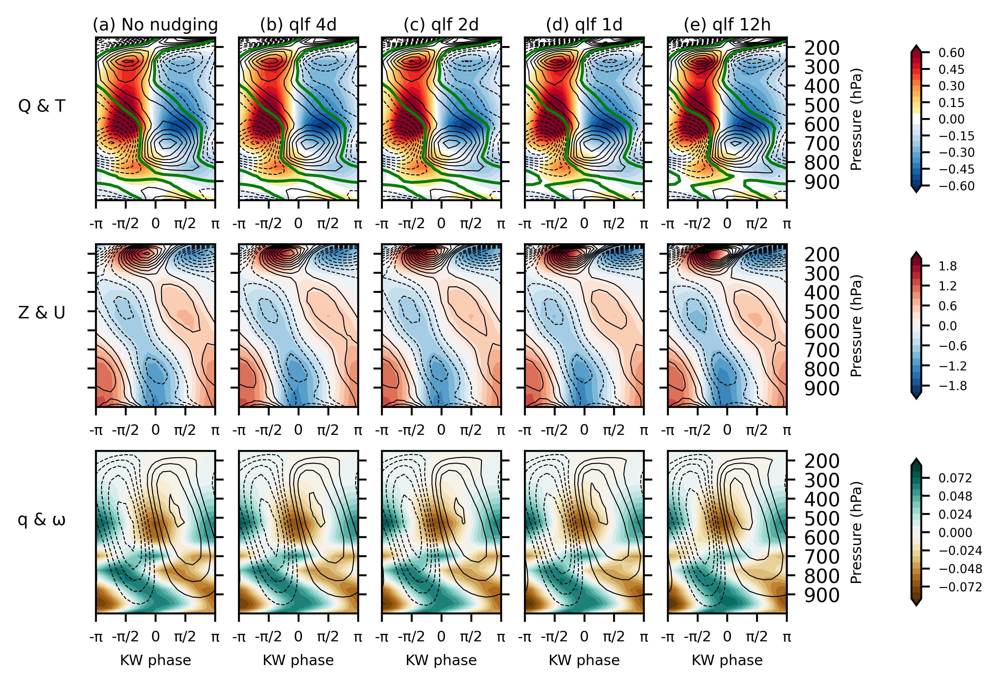

In [25]:
################################################
# Fig. 7: Plot vertical structure of each variable! (QT, UZ, q)
##############################################

# Load KW composite 3d variables
for inug in range(0, n_nudge):

    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'
    data = np.load(output_dir+'QTUVZq_kw.npz')
    
    if inug == 0:
        plev = data['plev']
        phase = data['phase']
        nlev  = np.size(plev)
        nphase = np.size(phase)
        Q_KW_all = np.empty([nphase, nlev, n_nudge])
        T_KW_all = np.empty([nphase, nlev, n_nudge])
        U_KW_all = np.empty([nphase, nlev, n_nudge])
        V_KW_all = np.empty([nphase, nlev, n_nudge])
        q_KW_all = np.empty([nphase, nlev, n_nudge])
        Z_KW_all = np.empty([nphase, nlev, n_nudge])
        W_KW_all = np.empty([nphase, nlev, n_nudge])

    Q_KW_all[:,:,inug] = data['Q_KW']
    T_KW_all[:,:,inug] = data['T_KW']
    U_KW_all[:,:,inug] = data['U_KW']
    V_KW_all[:,:,inug] = data['V_KW']
    q_KW_all[:,:,inug] = data['q_KW']
    Z_KW_all[:,:,inug] = data['Z_KW']
    W_KW_all[:,:,inug] = data['W_KW']


# Plot vertical structure of KW
font = 6
normalize_by_kwpr = 1 # or 0
norm = list(['','_normalize_by_kwpr'])    
        
# PLotting
plot_fignum = 3 
clev_0 = 0
txt_xloc = -6
txt_yloc = (np.min(plev)+np.max(plev))/2
row_name = list(['Q & T','Z & U','q & \u03C9'])
xx, yy = np.meshgrid(phase, plev)

ilevmin_Q = 0
ilevmax_Q = np.size(plev)-1

fig,axes = plt.subplots(plot_fignum,5,figsize=(6.5, 4),dpi=600)
plt.subplots_adjust(left=0.1,right=0.95,top=0.93,bottom=0.1,hspace=0.27)
plt.rcParams.update({'font.size': font})
for iplt in range(0,5):

    if normalize_by_kwpr == 1:
        c = kw_amp_all[iplt]
        const_clev = 2.5
    else:
        c = 1
        const_clev = 1
            
    # Set contour and contourf levels
    clev_n  = np.arange(-6,0,0.5)*0.5/4/const_clev #T
    clev_p  = np.arange(0.5,6.5,0.5)*0.5/4/const_clev #T
    clev    = np.arange(-6,6.5,0.5)/4/const_clev#*0.5 #Q
    clev1_n = np.arange(-3.3,0,0.3)/const_clev #U
    clev1_p = np.arange(0.3,3.3,0.3)/const_clev #U
    clev1   = np.arange(-5,5.5,0.5)/const_clev #Z
    clev2   = np.arange(-0.22,0.24,0.02)/const_clev #q
    clev2_n = np.arange(-0.2,0,0.01)/const_clev #W
    clev2_p = np.arange(0.01,0.2,0.01)/const_clev #W
    
    VAR_cf  = Q_KW_all[:,ilevmin_Q:ilevmax_Q+1,iplt]*s2d/c
    VAR_cn  = T_KW_all[:,ilevmin_Q:ilevmax_Q+1,iplt]/c                
    VAR1_cf = Z_KW_all[:,ilevmin_Q:ilevmax_Q+1,iplt]/c
    VAR2_cf = q_KW_all[:,ilevmin_Q:ilevmax_Q+1,iplt]*1000/c
    VAR1_cn = U_KW_all[:,ilevmin_Q:ilevmax_Q+1,iplt]/c
    VAR2_cn = W_KW_all[:,ilevmin_Q:ilevmax_Q+1,iplt]/c

    plt.subplot(plot_fignum,5,iplt+1)
    ax = plt.gca()
    plt.title(title_short[iplt],pad=3, loc='center',fontsize=7)
    cf  = plt.contourf(xx, yy, VAR_cf.T, levels=clev, cmap=get_cmap(RWB), extend='both' )
    cn_p = plt.contour(xx, yy, VAR_cn.T, levels=clev_p, colors='k', linewidths=0.4)
    cn_0 = plt.contour(xx, yy, VAR_cn.T, levels=clev_0, colors='g', linewidths=1.2)
    cn_n = plt.contour(xx, yy, VAR_cn.T, levels=clev_n, colors='k', linestyles='dashed',linewidths=0.4)
    plt.ylim([150, np.max(plev)])
    plt.yticks(np.arange(200,1000,100))
    plt.gca().invert_yaxis()
    plt.xticks(np.arange(-pi,pi+pi/2,pi/2),('-'+PI,'-'+PI+'/2','0',PI+'/2',PI),fontsize=font)
    plt.tick_params(bottom=True,top=False,left=False,right=True)
    if iplt == 0:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        plt.text(txt_xloc,txt_yloc,row_name[0],fontsize=7,horizontalalignment='center',verticalalignment='center') 
    elif iplt == 1 or iplt == 2 or iplt == 3:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
    elif iplt == 4:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=True)
        ax.yaxis.set_label_position("right")
        ax.set_ylabel('Pressure (hPa)',fontsize=font)
    if iplt == 4:
        cb = plt.colorbar(cf,ax=axes[0,:],orientation = 'vertical', shrink=.9, aspect=15,pad=0.13)
        cb.ax.tick_params(labelsize=5)
        
    plt.subplot(plot_fignum,5,5+iplt+1)
    ax = plt.gca()
    cf  = plt.contourf(xx, yy, VAR1_cf.T, levels=clev1, cmap='RdBu_r', extend='both' )
    cn_p = plt.contour(xx, yy, VAR1_cn.T, levels=clev1_p, colors='k', linewidths=0.4)
    cn_n = plt.contour(xx, yy, VAR1_cn.T, levels=clev1_n, colors='k', linestyles='dashed',linewidths=0.4)
    plt.ylim([150, np.max(plev)])
    plt.yticks(np.arange(200,1000,100))
    plt.gca().invert_yaxis()
    plt.xticks(np.arange(-pi,pi+pi/2,pi/2),('-'+PI,'-'+PI+'/2','0',PI+'/2',PI),fontsize=font)
    if iplt == 0:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        plt.text(txt_xloc,txt_yloc,row_name[1],fontsize=7,horizontalalignment='center',verticalalignment='center') 
    elif iplt == 1 or iplt == 2 or iplt == 3:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
    elif iplt == 4:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=True)
        ax.yaxis.set_label_position("right")
        ax.set_ylabel('Pressure (hPa)',fontsize=font)
    if iplt == 4:
        cb = plt.colorbar(cf,ax=axes[1,:],orientation = 'vertical', shrink=.9, aspect=15,pad=0.13)
        cb.ax.tick_params(labelsize=5)

    plt.subplot(plot_fignum,5,5*2+iplt+1)
    ax = plt.gca()
    cf  = plt.contourf(xx, yy, VAR2_cf.T, levels=clev2, cmap='BrBG', extend='both' )
    cn_p = plt.contour(xx, yy, VAR2_cn.T, levels=clev2_p, colors='k', linewidths=0.4)
    cn_n = plt.contour(xx, yy, VAR2_cn.T, levels=clev2_n, colors='k', linestyles='dashed',linewidths=0.4) 
    plt.ylim([150, np.max(plev)])
    plt.yticks(np.arange(200,1000,100))
    plt.gca().invert_yaxis()
    plt.xticks(np.arange(-pi,pi+pi/2,pi/2),('-'+PI,'-'+PI+'/2','0',PI+'/2',PI),fontsize=font)
    plt.tick_params(bottom=True,top=False,left=False,right=True)
    if iplt == 0:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        plt.text(txt_xloc,txt_yloc,row_name[2],fontsize=7,horizontalalignment='center',verticalalignment='center') 
    elif iplt == 1 or iplt == 2 or iplt == 3:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
    elif iplt == 4:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=True)
        ax.yaxis.set_label_position("right")
        ax.set_ylabel('Pressure (hPa)',fontsize=font)
    plt.xlabel('KW phase',fontsize=font)
    if iplt == 4:
        cb = plt.colorbar(cf,ax=axes[2,:],orientation = 'vertical', shrink=.9, aspect=15,pad=0.13)
        cb.ax.tick_params(labelsize=5)

plt.savefig(figdir_all+'fig8_QTZUq_KW'+norm[normalize_by_kwpr]+'.png',dpi=600)
plt.show()
plt.close()

In [6]:
###############################
# Calculate EOF
############################
saved_eof = 0

if saved_eof == 1:

    for inug in range(0,n_nudge):
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
        data = np.load(output_dir+'EOF.npz')
        plev = data['plev']
        nlev = np.size(plev)

        if inug == 0:
            R_EOF1_raw_all    = np.empty([nlev, n_nudge])
            R_EOF2_raw_all    = np.empty([nlev, n_nudge])
            R_EOF1_smooth_all = np.empty([nlev, n_nudge])
            R_EOF2_smooth_all = np.empty([nlev, n_nudge])
            
        R_EOF1_raw_all[:,inug]    = data['R_EOF1_raw']
        R_EOF2_raw_all[:,inug]    = data['R_EOF2_raw']
        R_EOF1_smooth_all[:,inug] = data['R_EOF1_smooth']
        R_EOF2_smooth_all[:,inug] = data['R_EOF2_smooth']

        # Load Qa
        data  = np.load(output_dir+'QTUVZq.npz')
        time  = data['time']
        plev  = data['plev']
        lon   = data['lon']

        nt    = np.size(time)
        nlev  = np.size(plev)
        nlon  = np.size(lon)
        
        # Calculate PC
        #Qa    = data['Qa'] #(time, plev, lon), projected Q, without 10-day low pass filtered variability
        #Qa_reshape = np.transpose(Qa,(0,2,1))
        Qproj = data['Qproj']
        Qm    = np.mean(np.mean(Qproj, 2),0)
        Qm_large = np.tile(Qm, (nt, nlon, 1))
        Qproj_reshape = np.transpose(Qproj,(0,2,1))
        Qa_reshape = Qproj_reshape-Qm_large
        #print(np.shape(Qa_reshape))
        PCQ1 = np.inner(Qa_reshape, R_EOF1_smooth_all[:,inug])
        print(np.shape(PCQ1))
        PCQ2 = np.inner(Qa_reshape, R_EOF2_smooth_all[:,inug])
        print(np.shape(PCQ2))        

        np.savez(output_dir+'PCQ.npz', PCQ1=PCQ1, PCQ2=PCQ2,\
            time=time, plev=plev, lon=lon)
else:
    for inug in range(0,n_nudge):
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
        data = np.load(output_dir+'EOF.npz')
        plev = data['plev']
        nlev = np.size(plev)

        if inug == 0:
            R_EOF1_smooth_all = np.empty([nlev, n_nudge])
            R_EOF2_smooth_all = np.empty([nlev, n_nudge])
            
        R_EOF1_smooth_all[:,inug] = data['R_EOF1_smooth']
        R_EOF2_smooth_all[:,inug] = data['R_EOF2_smooth']

        # Load PC
        data = np.load(output_dir+'PCQ.npz')
        PCQ1 = data['PCQ1']
        PCQ2 = data['PCQ2']

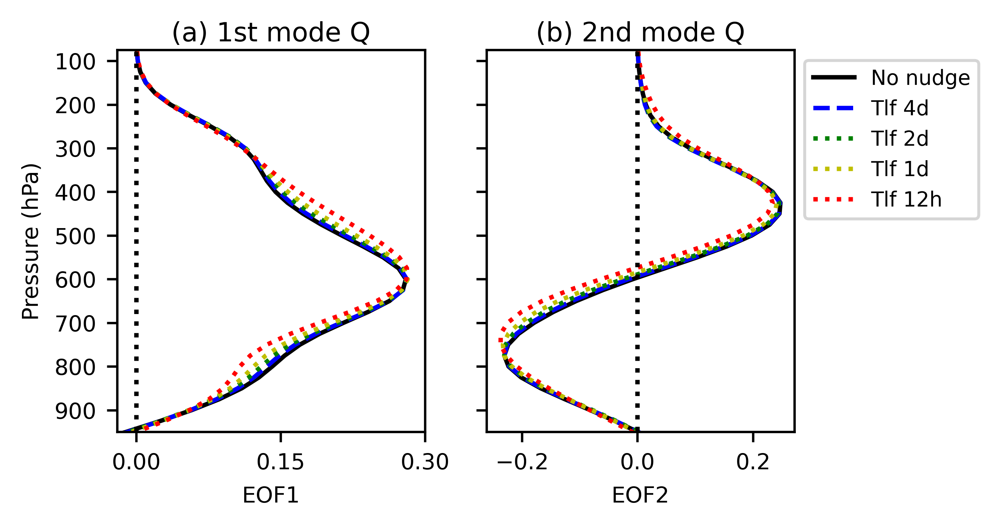

In [9]:
###################################################
# Fig. 6: Plot EOF vertical profile: EOF1, EOFU
###################################################
mark_melting_level = 0
plot_eof = 1
    
# Plot 2 figures together
font = 7.5
fig,axes = plt.subplots(1,2,figsize=(5.5, 2.4),dpi=600)
plt.subplots_adjust(left=0.22,right=0.8,top=0.9,bottom=0.15,wspace=0.2,hspace=0.3)
plt.rcParams.update({'font.size': font})
zero = np.zeros([nlev])
#for inug in range(0,n_nudge):
if plot_eof == 1:
    # Plot EOF1
    plt.subplot(1,2,1)
    ax = plt.gca()
    plt.plot(R_EOF1_smooth_all[:,0], plev, 'k')
    plt.plot(R_EOF1_smooth_all[:,1], plev, 'b--')
    plt.plot(R_EOF1_smooth_all[:,2], plev, 'g:')
    plt.plot(R_EOF1_smooth_all[:,3], plev, 'y:')
    plt.plot(R_EOF1_smooth_all[:,4], plev, 'r:')
    plt.xticks(np.arange(-0.3,0.6,0.3))
    plt.plot(zero, plev,'k:')
    plt.tick_params(bottom=True,top=False,left=True,right=False)
    #plt.ylim([np.min(plev), np.max(plev)]) 
    plt.ylim([75, 950]) 
    plt.yticks(np.arange(100,1000,100))
    plt.gca().invert_yaxis()
    plt.title('(a) 1st mode Q', pad=3, loc='center',fontsize=9)
    plt.ylabel('Pressure (hPa)')
    plt.tick_params(labelbottom=True,labeltop=False,labelleft=True,labelright=False)
    plt.xlabel('EOF1')
    plt.xticks(np.arange(0,0.45,0.15))
    plt.xlim([-0.02,0.3])
    # Mark melting level:
    if mark_melting_level == 1:
        plt.plot( 0, plev_ref[ilev_melt[icase]], 'gx',markersize=4)
    #
    # Plot EOF2
    plt.subplot(1,2,2)
    plt.plot(R_EOF2_smooth_all[:,0], plev, 'k')
    plt.plot(R_EOF2_smooth_all[:,1], plev, 'b--')
    plt.plot(R_EOF2_smooth_all[:,2], plev, 'g:')
    plt.plot(R_EOF2_smooth_all[:,3], plev, 'y:')
    plt.plot(R_EOF2_smooth_all[:,4], plev, 'r:')
    plt.xticks(np.arange(-0.3,0.6,0.3))
    plt.plot(zero, plev,'k:')
    plt.tick_params(bottom=True,top=False,left=True,right=False)
    #plt.ylim([np.min(plev), np.max(plev)]) 
    plt.ylim([75, 950]) 
    plt.yticks(np.arange(100,1000,100))
    plt.gca().invert_yaxis()
    plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
    plt.title('(b) 2nd mode Q', pad=3, loc='center',fontsize=9)
    ax = plt.gca()
    ax.legend(legend_list, bbox_to_anchor=(1, 1), loc='upper left',fontsize=7)
    # Mark melting level:
    if mark_melting_level == 1:
        plt.plot( 0, plev_ref[ilev_melt[icase]], 'gx',markersize=4)
    plt.xlabel('EOF2')
    plt.xticks(np.array([-0.2,0,0.2]))

plt.savefig(figdir_all+'fig5_EOF_Q.png',dpi=600)
plt.show()

EAPE gr1: [-4.59929228 -4.40189804 -4.13232287 -4.02218559 -4.00264429]
EAPE gr2: [3.40672768 3.15579363 2.90005933 2.84551731 2.61159157]


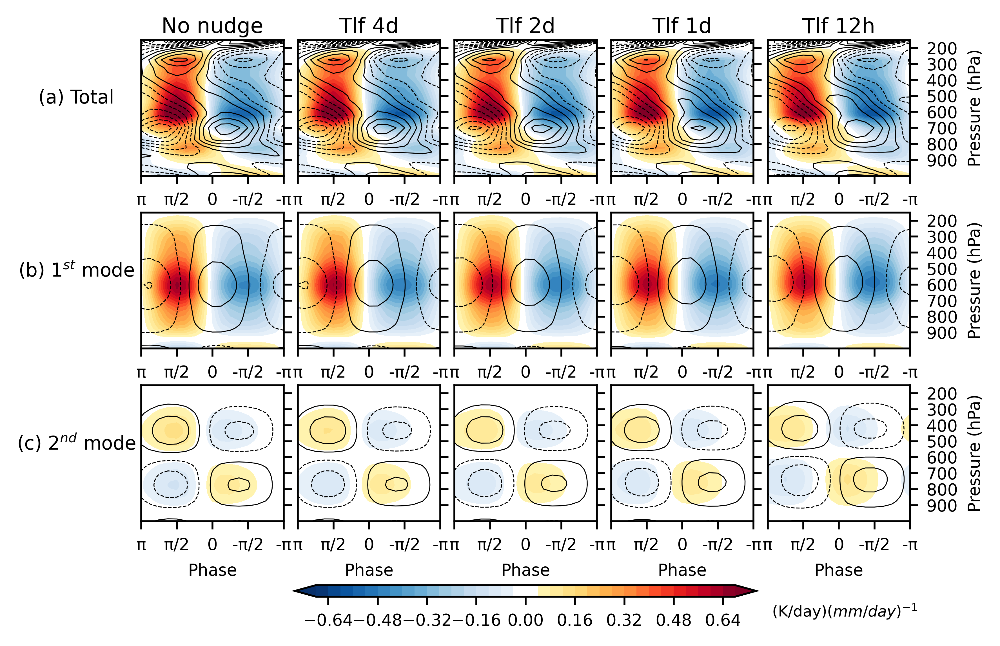

In [25]:
##############################################################
# Plot vertical mode decomposition for no nudge, nudge Q, nudge T
################################################
calc_vmd = 1

# Calculate vertical mode decomposition
if calc_vmd == 1:
    for inug in range(0, n_nudge):
    
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
    
        # lOAD EOF
        data = np.load(output_dir+'EOF.npz')
        EOF1 = data['R_EOF1_smooth']
        EOF2 = data['R_EOF2_smooth']
        plev = data['plev']
        nlev = np.size(plev)
    
        # lOAD KW COMPOSITE QT
        data = np.load(output_dir+'QTUVZq_kw.npz')
        phase = data['phase']
        nphase = np.size(phase)
        if inug == 0:
            Q_KW_all  = np.empty([nphase, nlev, n_nudge])
            Q1_KW_all = np.empty([nphase, nlev, n_nudge])
            Q2_KW_all = np.empty([nphase, nlev, n_nudge])
            T_KW_all  = np.empty([nphase, nlev, n_nudge])
            T1_KW_all = np.empty([nphase, nlev, n_nudge])
            T2_KW_all = np.empty([nphase, nlev, n_nudge])
            PCT1_KW_all = np.empty([nphase, n_nudge])
            PCT2_KW_all = np.empty([nphase, n_nudge])
            PCQ1_KW_all = np.empty([nphase, n_nudge])
            PCQ2_KW_all = np.empty([nphase, n_nudge])
        Q_KW_all[:,:,inug] = data['Q_KW']
        T_KW_all[:,:,inug] = data['T_KW']
        
        if np.size(Q_KW_all,1)!=np.size(plev):
            print('Vertical dimension mismatch between Q_KW and EOF1!')
        else:
            T1_KW_all[:,:,inug], T2_KW_all[:,:,inug] = KW.vertical_mode_decomposition(T_KW_all[:,:,inug], EOF1, EOF2)
            Q1_KW_all[:,:,inug], Q2_KW_all[:,:,inug] = KW.vertical_mode_decomposition(Q_KW_all[:,:,inug], EOF1, EOF2)
            PCT1_KW_all[:,inug] = np.inner(T_KW_all[:,:,inug], EOF1)
            PCQ1_KW_all[:,inug] = np.inner(Q_KW_all[:,:,inug], EOF1)
            PCT2_KW_all[:,inug] = np.inner(T_KW_all[:,:,inug], EOF2)
            PCQ2_KW_all[:,inug] = np.inner(Q_KW_all[:,:,inug], EOF2)
            if inug == 0:
                EAPE_GR1 = np.empty([n_nudge])
                EAPE_GR2 = np.empty([n_nudge])
            EAPE_GR1[inug] = 2*np.mean(PCQ1_KW_all[:,inug]*PCT1_KW_all[:,inug],0)/np.mean(PCT1_KW_all[:,inug]**2,0)*s2d
            EAPE_GR2[inug] = 2*np.mean(PCQ2_KW_all[:,inug]*PCT2_KW_all[:,inug],0)/np.mean(PCT2_KW_all[:,inug]**2,0)*s2d
    
    np.savez(output_dir_all+'kw_composite_PC1_PC2.npz', PCQ1_KW_all=PCQ1_KW_all, PCQ2_KW_all=PCQ2_KW_all,\
             PCT1_KW_all=PCT1_KW_all, PCT2_KW_all=PCT2_KW_all, phase=phase, NUDGE_LIST=NUDGE_LIST)
    
    np.savez(output_dir_all+'kw_composite_QT_vertical_mode_decomposition.npz',T_KW_all=T_KW_all, Q_KW_all=Q_KW_all,\
        T1_KW_all=T1_KW_all, T2_KW_all=T2_KW_all,\
        Q1_KW_all=Q1_KW_all, Q2_KW_all=Q2_KW_all,\
        plev=plev, phase=phase, NUDGE_LIST=NUDGE_LIST)
    
    np.savez(output_dir_all+'EAPE_growth_rate.npz',EAPE_GR1=EAPE_GR1, EAPE_GR2=EAPE_GR2, NUDGE_LIST=NUDGE_LIST)
else:
    data = np.load(output_dir_all+'kw_composite_QT_vertical_mode_decomposition.npz')
    Q_KW_all  = data['Q_KW_all']
    Q1_KW_all = data['Q1_KW_all']
    Q2_KW_all = data['Q2_KW_all']
    T_KW_all  = data['T_KW_all']
    T1_KW_all = data['T1_KW_all']
    T2_KW_all = data['T2_KW_all']
    phase     = data['phase']
    plev      = data['plev']

    data = np.load(output_dir_all+'EAPE_growth_rate.npz')
    EAPE_GR1 = data['EAPE_GR1']
    EAPE_GR2 = data['EAPE_GR2']
    
print('EAPE gr1:',EAPE_GR1)
print('EAPE gr2:',EAPE_GR2)

###################################################
# Plot figures
#########################################
normalize_by_kwpr = 1
if normalize_by_kwpr == 1:
    c = 2.5 # divide by this constant for clev
else:
    c = 1

plot_fignum = 3 # how many rows
txt_xloc = -6
txt_yloc = (np.min(plev)+np.max(plev))/2
row_name = list(['(a) Total','(b) 1$^{st}$ mode','(c) 2$^{nd}$ mode'])
clev_0 = 0
font = 7
plev_min = 150

# Load KW amplitude
data = np.load(output_dir_all+'kw_pr_amplitude.npz')
kw_amp_all = data['kw_amp_all']
#print(kw_amp_all)

for iplt in range(0,1): #(iplt=0, QT)
    
    fig,axes = plt.subplots(3,5,figsize=(6.5, 4),dpi=600)
    plt.subplots_adjust(left=0.2,right=0.9,top=0.95,bottom=0,hspace=0.27,wspace=0.1)
    plt.rcParams.update({'font.size': font})
    
    if iplt == 0:
        clev = np.arange(-1.7,1.8,0.1)/c
        clev_n = (np.arange(-0.96,0,0.08)+0.04)/c
        clev_p = (np.arange(0.08,1.04,0.08)-0.04)/c
        var_cf  = globals()['Q_KW_all']*s2d
        var_cn  = globals()['T_KW_all']
        var1_cf = globals()['Q1_KW_all']*s2d
        var2_cf = globals()['Q2_KW_all']*s2d
        var1_cn = globals()['T1_KW_all']
        var2_cn = globals()['T2_KW_all']
    
    if normalize_by_kwpr == 1:
        for inug in range(0,n_nudge):
            var_cf[:,:,inug]  = var_cf[:,:,inug]/kw_amp_all[inug]
            var_cn[:,:,inug]  = var_cn[:,:,inug]/kw_amp_all[inug]
            var1_cf[:,:,inug] = var1_cf[:,:,inug]/kw_amp_all[inug]
            var2_cf[:,:,inug] = var2_cf[:,:,inug]/kw_amp_all[inug]
            var1_cn[:,:,inug] = var1_cn[:,:,inug]/kw_amp_all[inug]
            var2_cn[:,:,inug] = var2_cn[:,:,inug]/kw_amp_all[inug]

    for i in range(0,5): #icase

        real_i = i
        
        plt.subplot(plot_fignum,5,i+1)
        ax = plt.gca()
        plt.title(title_noabc[i], pad=3, loc='center',fontsize=9)
        xx, yy = np.meshgrid(phase, plev)
        cf  = plt.contourf(xx, yy, var_cf[:,:,real_i].T, levels=clev, cmap=get_cmap(RWB), extend='both' )
        cn_p = plt.contour(xx, yy, var_cn[:,:,real_i].T, levels=clev_p, colors='k', linewidths=0.4)
        #cn_0 = plt.contour(xx, yy, var_cn[:,:,real_i].T, levels=clev_0, colors='g', linewidths=0.8)
        cn_n = plt.contour(xx, yy, var_cn[:,:,real_i].T, levels=clev_n, colors='k', linestyles='dashed',linewidths=0.4)
        plt.ylim([plev_min,np.max(plev)])
        plt.yticks(np.arange(200,1000,100),fontsize=font)
        plt.gca().invert_yaxis()
        plt.xticks(bin_simple2,(PI,PI+'/2','0','-'+PI+'/2','-'+PI),fontsize=font)
        plt.tick_params(bottom=True,top=False,left=False,right=True)
        if i == 0:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
            plt.text(txt_xloc,txt_yloc,row_name[0],fontsize=8,horizontalalignment='center',verticalalignment='center') 
        elif i == 1 or i == 2 or i == 3:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        elif i == 4:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=True)
            ax.yaxis.set_label_position("right")
            ax.set_ylabel('Pressure (hPa)',fontsize=font)

        plt.subplot(plot_fignum,5,i+1+5)
        ax = plt.gca()
        cf  = plt.contourf(xx, yy, var1_cf[:,:,real_i].T, levels=clev, cmap=get_cmap(RWB), extend='both' )
        cn_p = plt.contour(xx, yy, var1_cn[:,:,real_i].T, levels=clev_p, colors='k', linewidths=0.4)
        cn_n = plt.contour(xx, yy, var1_cn[:,:,real_i].T, levels=clev_n, colors='k', linestyles='dashed',linewidths=0.4)
        plt.ylim([plev_min,np.max(plev)])
        plt.yticks(np.arange(200,1000,100),fontsize=font)
        plt.gca().invert_yaxis()
        plt.xticks(bin_simple2,(PI,PI+'/2','0','-'+PI+'/2','-'+PI),fontsize=font)
        plt.tick_params(bottom=True,top=False,left=False,right=True)
        if i == 0:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
            plt.text(txt_xloc,txt_yloc,row_name[1],fontsize=8,horizontalalignment='center',verticalalignment='center') 
        elif i == 1 or i == 2 or i == 3:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        elif i == 4:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=True)
            ax.yaxis.set_label_position("right")
            ax.set_ylabel('Pressure (hPa)',fontsize=font)

        plt.subplot(plot_fignum,5,i+1+10)
        ax = plt.gca()
        cf  = plt.contourf(xx, yy, var2_cf[:,:,real_i].T, levels=clev, cmap=get_cmap(RWB), extend='both' )
        cn_p = plt.contour(xx, yy, var2_cn[:,:,real_i].T, levels=clev_p, colors='k', linewidths=0.4)
        cn_n = plt.contour(xx, yy, var2_cn[:,:,real_i].T, levels=clev_n, colors='k', linestyles='dashed',linewidths=0.4) 
        plt.ylim([plev_min, np.max(plev)])
        plt.yticks(np.arange(200,1000,100),fontsize=font)
        plt.gca().invert_yaxis()
        plt.xticks(bin_simple2,(PI,PI+'/2','0','-'+PI+'/2','-'+PI),fontsize=font)
        plt.tick_params(bottom=True,top=False,left=False,right=True)
        if i == 0:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
            plt.text(txt_xloc,txt_yloc,row_name[2],fontsize=8,horizontalalignment='center',verticalalignment='center') 
        elif i == 1 or i == 2 or i == 3:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        elif i == 4:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=True)
            ax.yaxis.set_label_position("right")
            ax.set_ylabel('Pressure (hPa)',fontsize=font)

        plt.xlabel('Phase',fontsize=font)
    cb = plt.colorbar(cf,ax=axes[:,:],orientation = 'horizontal', shrink=.6, aspect=40,pad=0.1) 
    ax.text(0.03, -0.73, '(K/day)$(mm/day)^{-1}$',\
                verticalalignment='bottom', horizontalalignment='left',transform=ax.transAxes,\
                color='k', fontsize=6.5)
    if iplt == 0:
        plt.savefig(figdir_all+'fig7_QT_KW_1st_2nd.png',dpi=600)
    plt.show()

In [6]:
######################################
# PLot coh^2 between PC1 and PC2 (cf 0-4.Calculate_coh2.ipynb, located in Final_paper (paper2) directory)
# Verify that coupling between the two modes weaken!
#############################################
saved_coh_PCQ1_PCQ2 = 0

if saved_coh_PCQ1_PCQ2 == 0:
    
    for inug in range(0,n_nudge):
        
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'

        # Load PCQ1, PCQ2
        data = np.load(output_dir+'PCQ.npz')
        PCQ1 = data['PCQ1']
        PCQ2 = data['PCQ2']
        
        # Calculate anomaly
        PCQ1_ano = PCQ1-np.nanmean(PCQ1)
        PCQ2_ano = PCQ2-np.nanmean(PCQ2)
    
        # To obtain size of wavenum and freq
        tmp, tmp2, tmp3, tmp4, x, y, freq, zwnum = KW.calculate_coh2_spectrum(PCQ1_ano, PCQ2_ano)
        del tmp, tmp2, tmp3, tmp4
        n0 = np.size(x,0)
        n1 = np.size(x,1)
    
        if inug == 0:
            coh_PCQ1_PCQ2_all = np.empty([n0,n1,n_nudge])
            sin_PCQ1_PCQ2_all = np.empty([n0,n1,n_nudge])
            cos_PCQ1_PCQ2_all = np.empty([n0,n1,n_nudge])
    
        # Calculate coh^2
        coh_PCQ1_PCQ2_all[:,:,inug], sin_PCQ1_PCQ2_all[:,:,inug], cos_PCQ1_PCQ2_all[:,:,inug], \
                coh_crit, x, y, freq, zwnum = KW.calculate_coh2_spectrum(PCQ2_ano, PCQ1_ano)
    
    np.savez(output_dir_all+'coh2_spectrum.npz',\
                    coh_PCQ1_PCQ2_all=coh_PCQ1_PCQ2_all, \
                     sin_PCQ1_PCQ2_all=sin_PCQ1_PCQ2_all,\
                     cos_PCQ1_PCQ2_all=cos_PCQ1_PCQ2_all,\
                    x=x, y=y, freq=freq, zwnum=zwnum, coh_crit=coh_crit)

else:
    data = np.load(output_dir_all+'coh2_spectrum.npz')
    coh_PCQ1_PCQ2_all = data['coh_PCQ1_PCQ2_all']
    sin_PCQ1_PCQ2_all = data['sin_PCQ1_PCQ2_all']
    cos_PCQ1_PCQ2_all = data['cos_PCQ1_PCQ2_all']
    x                 = data['x']
    y                 = data['y']
    zwnum             = data['zwnum']
    freq              = data['freq']

/glade/u/ssg/ch/usr/jupyterhub/envs/cmip6-201910a/lib/python3.7/site-packages/ipykernel_launcher.py:36: ComplexWarning: Casting complex values to real discards the imaginary part


he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


/glade/u/home/muting/.local/lib/python3.7/site-packages/numpy/ma/core.py:2830: ComplexWarning: Casting complex values to real discards the imaginary part
  order=order, subok=True, ndmin=ndmin)


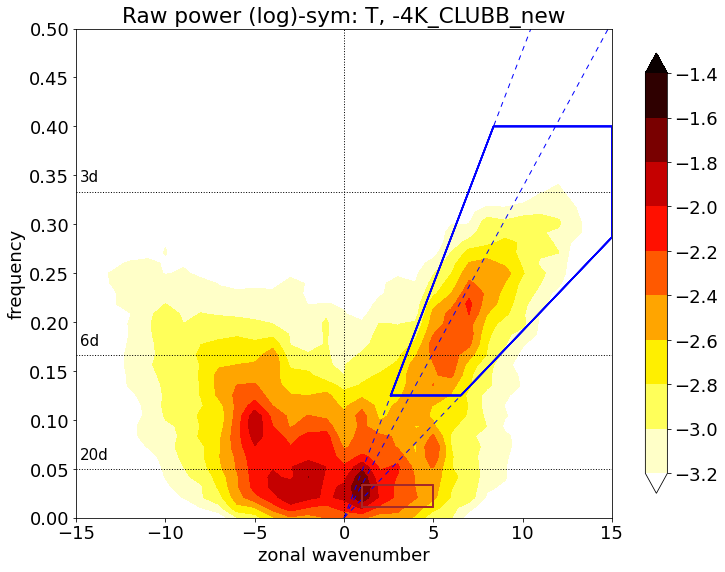

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


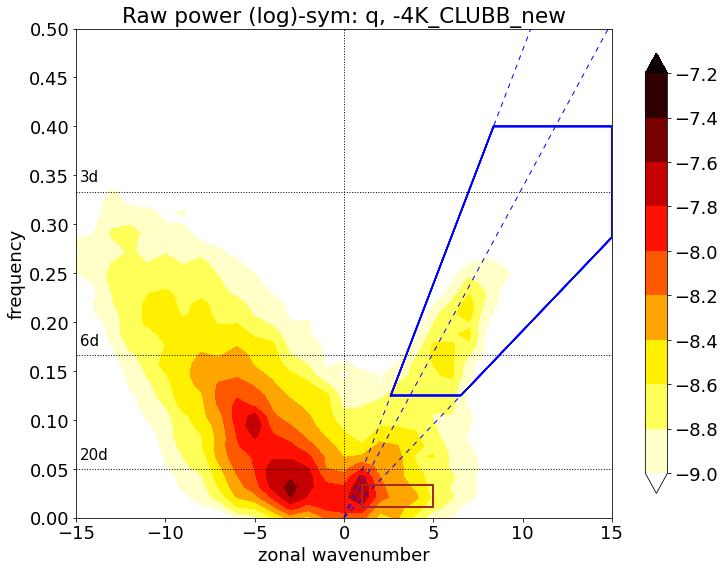

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


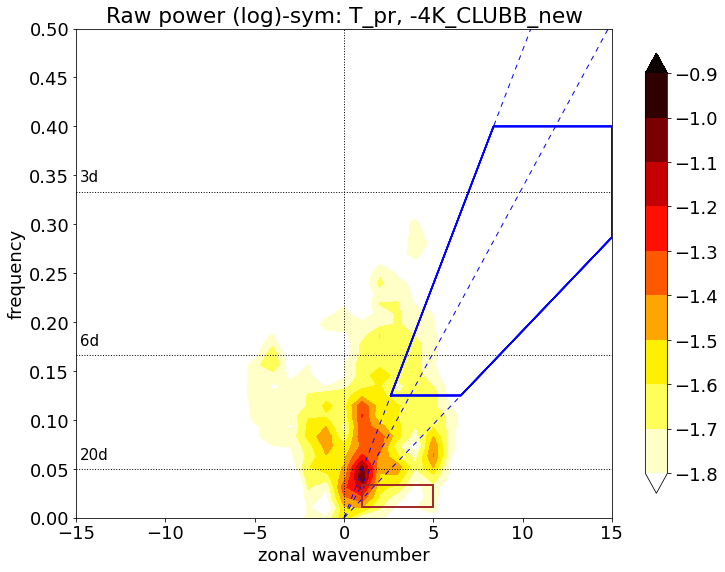

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


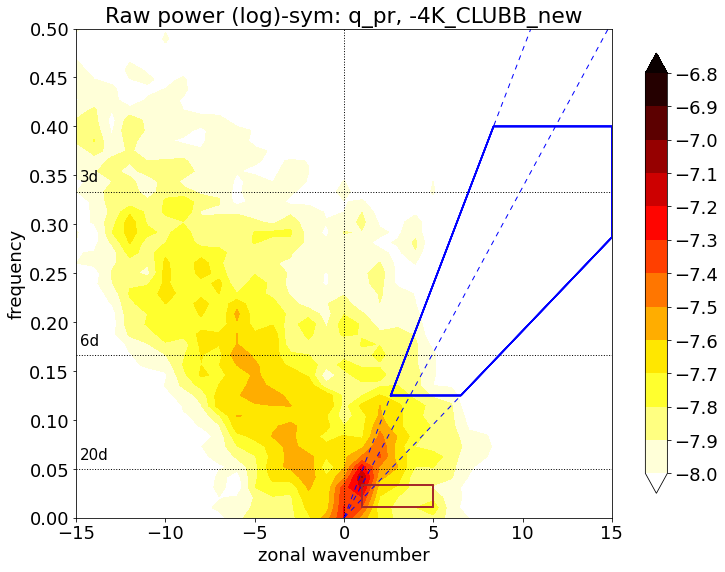

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


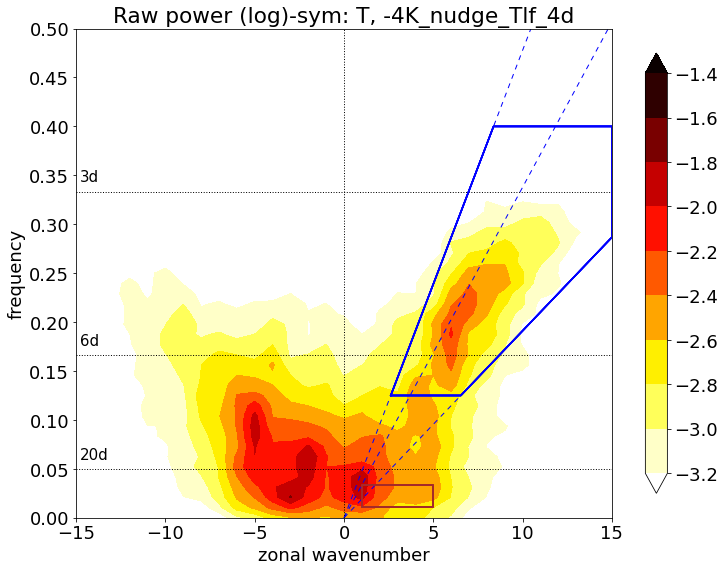

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


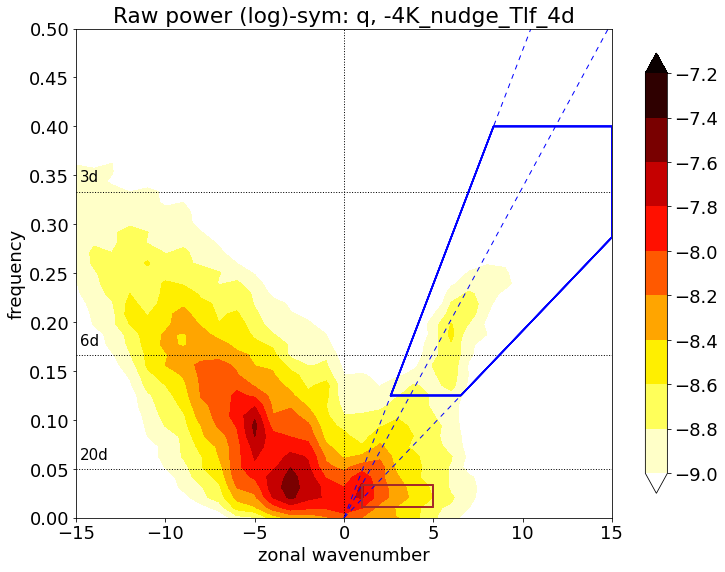

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


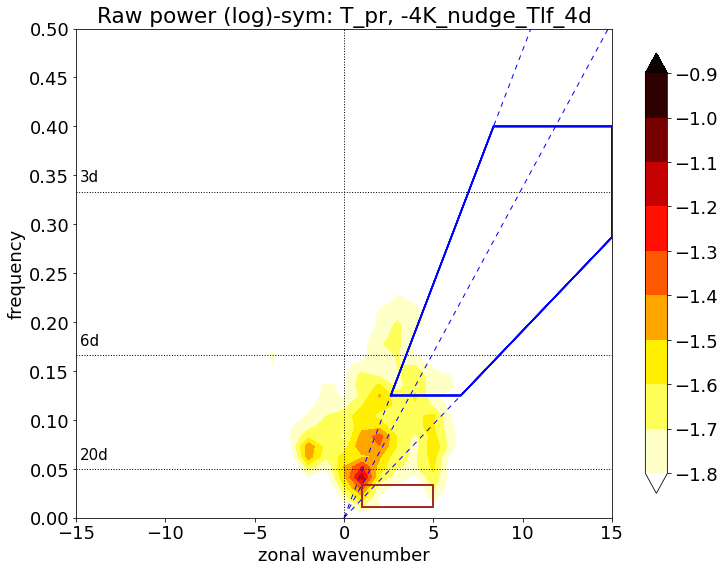

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


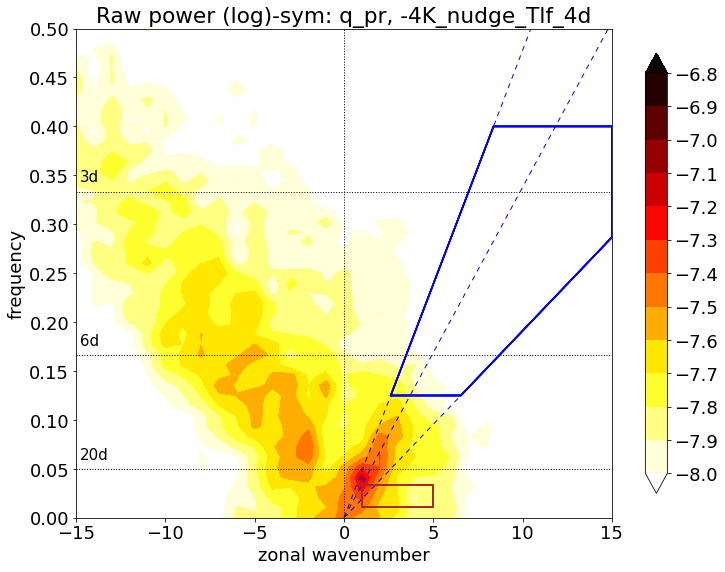

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


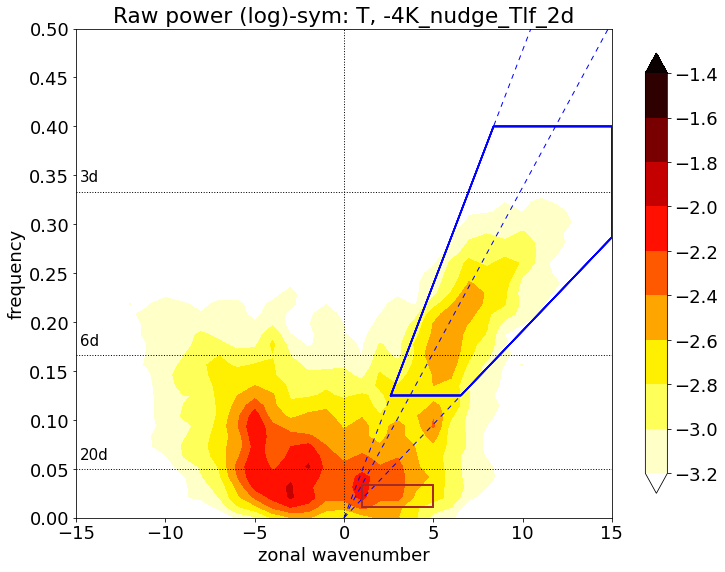

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


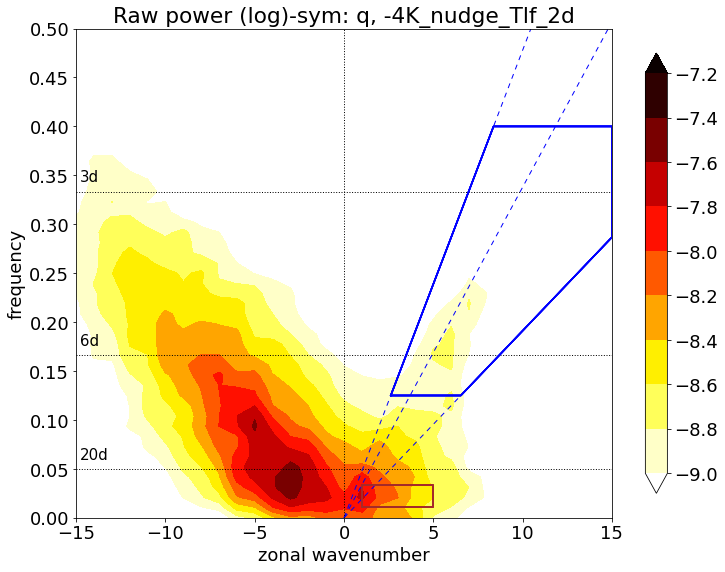

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


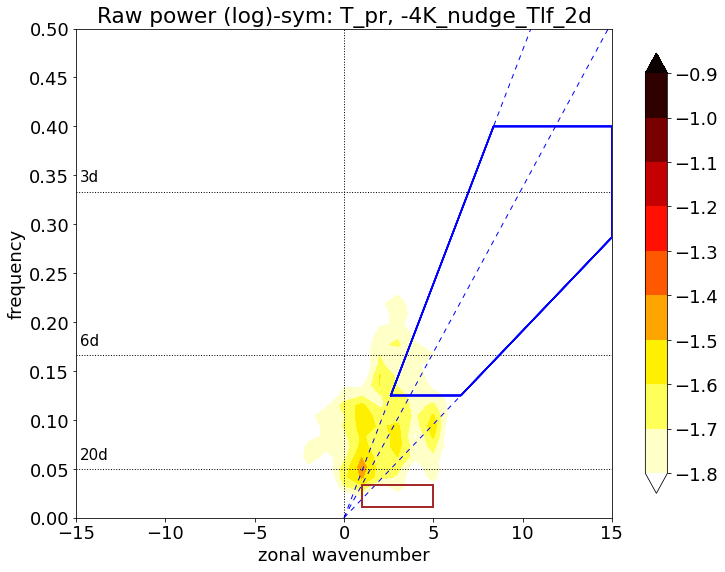

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


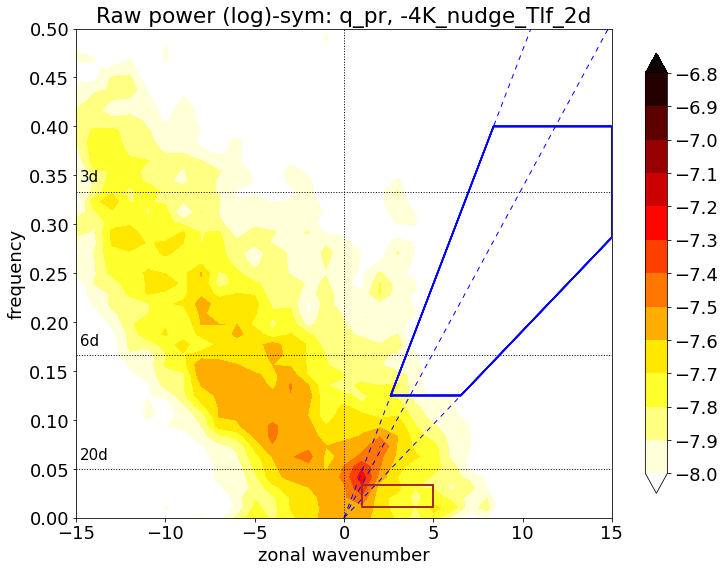

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


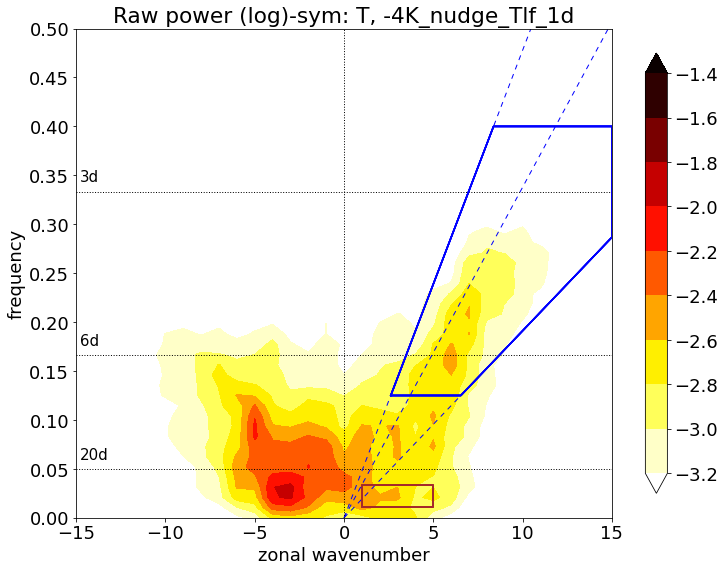

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


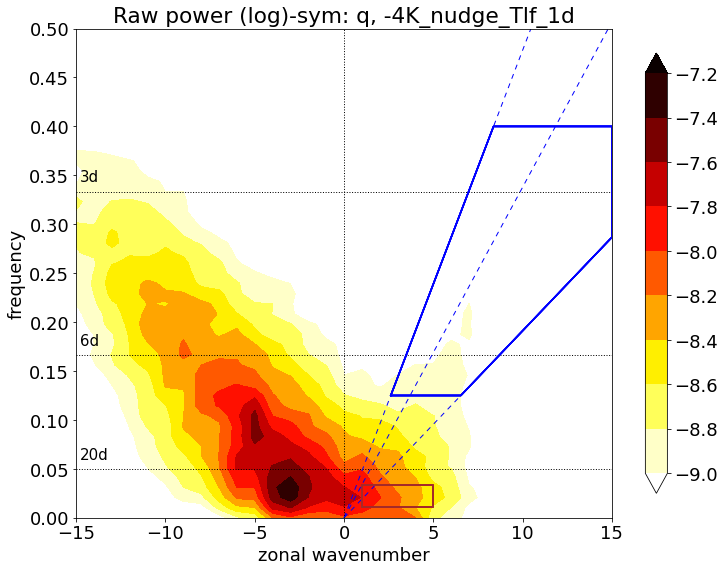

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


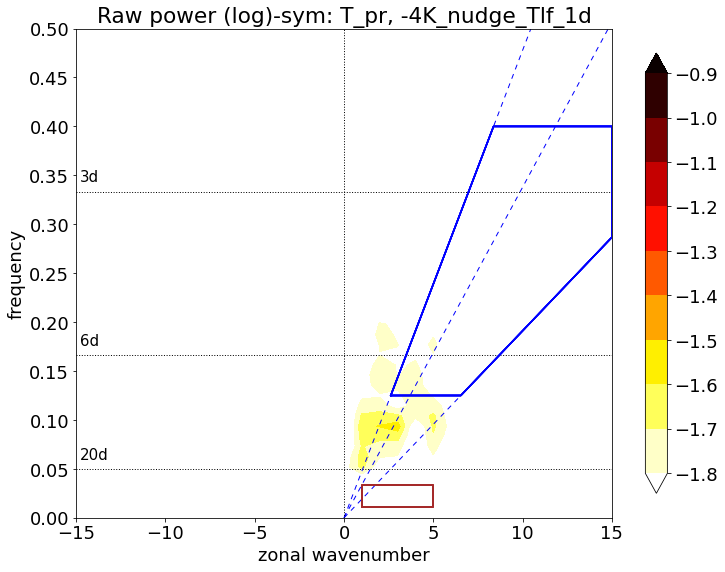

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


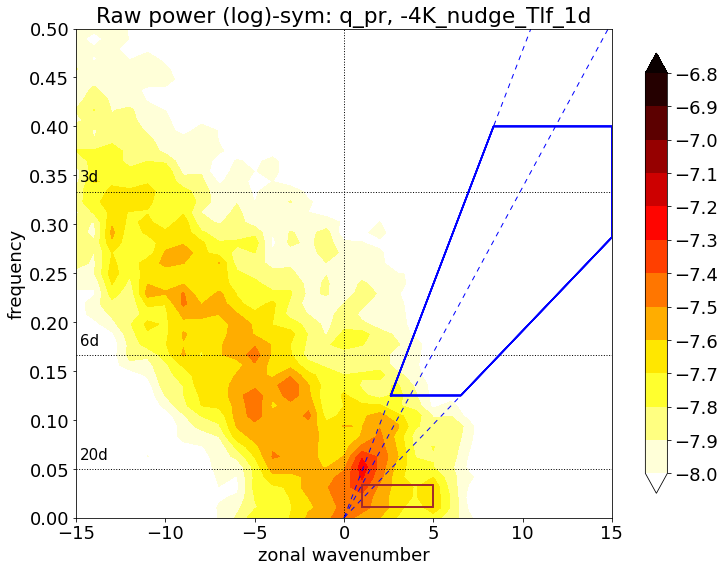

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


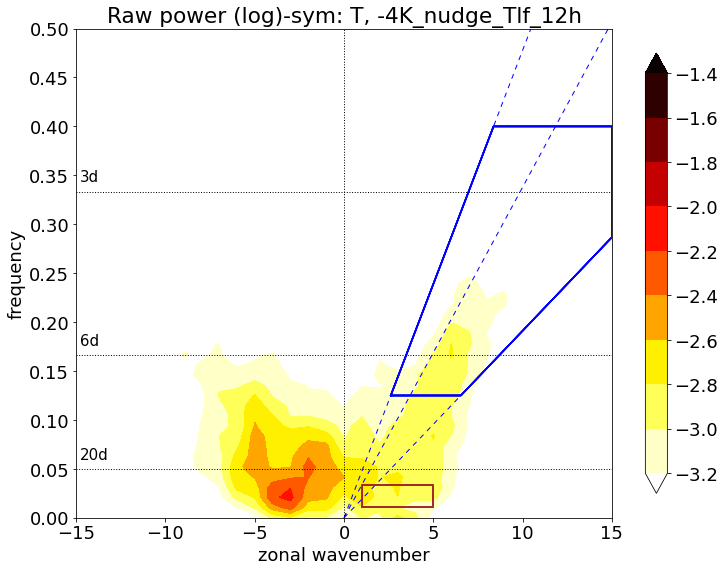

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


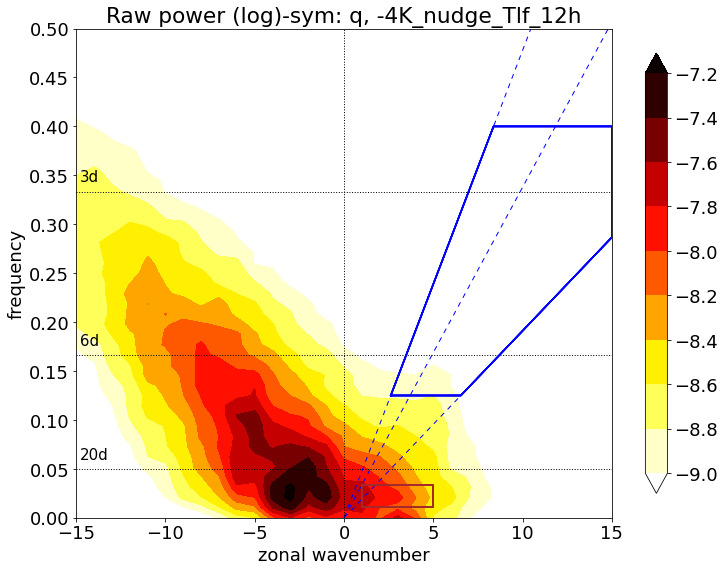

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


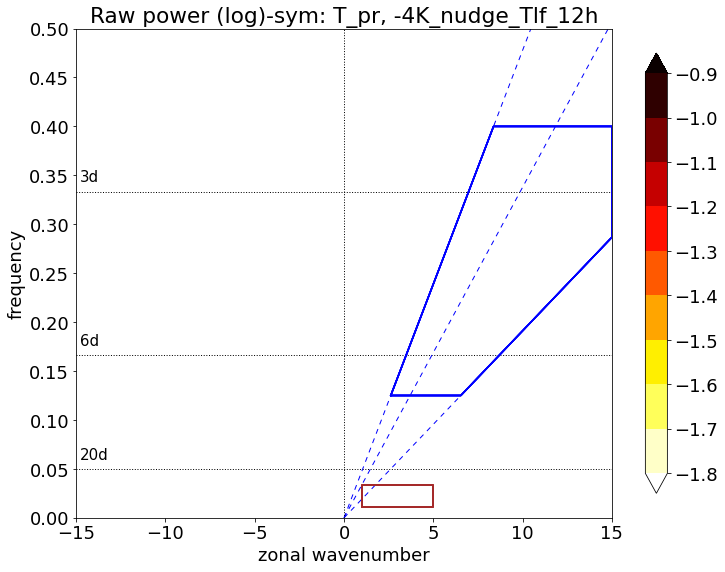

he: [ 8 25 50]
Cp: [ 8.85437745 15.65247584 22.13594362]


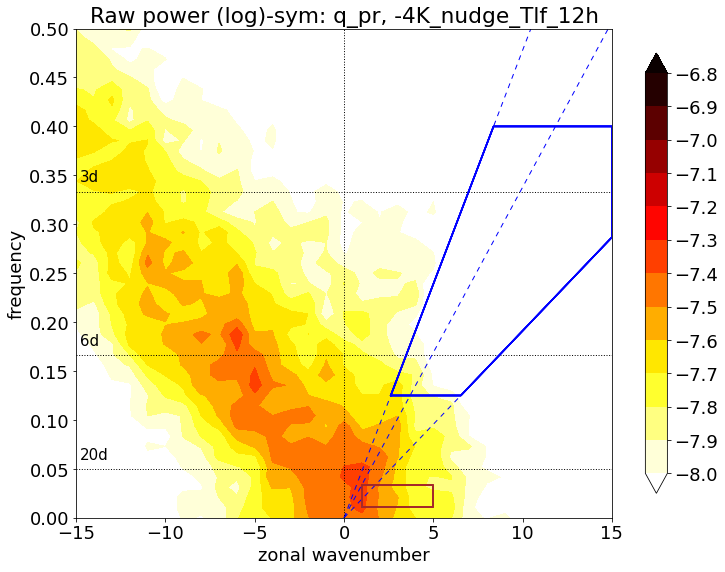

In [11]:
###########################################
# Plot T variance and q variance at 700 hPa, not used for now
###########################################
save_q_T_ano = 1
save_coh2 = 1
if save_q_T_ano == 1:
    for inug in range(0,n_nudge):
    
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
        latmax = 10
    
        if inug == 0:
            CASENAME_SHORT = CASENAME_SHORT_LIST[icase]+'_CLUBB_new'
        else:
            CASENAME_SHORT = CASENAME_SHORT_LIST[icase]+'_'+NUDGE_LIST[inug]
    
        # (0) Get nfile_skip
        nfile_skip = KW.find_nfile_skip(CASENAME, CASENAME_SHORT, iyr_min, iyr_max, from_cheyenne=0)
        
        # (1) Load T and Q, U, gph, W & Calculate anomaly
        vname = list(['T'])
        T, Tm, time, plev, lon, lat = KW.load_3D_data_as_1variable(CASENAME, CASENAME_SHORT, vname, iyr_min, iyr_max,\
                                                              latmax, nfile_skip, from_cheyenne=0, kw_proj=0)
        
        vname = list(['Q'])
        q, qm, time, plev, lon, lat = KW.load_3D_data_as_1variable(CASENAME, CASENAME_SHORT, vname, iyr_min, iyr_max, \
                                                              latmax, nfile_skip, from_cheyenne=0, kw_proj=0)
    
        T2 = np.transpose(T, (0,2,3,1))
        T_mean = np.mean(np.mean(T2,2),0)
        T_m = np.tile(T_mean,(np.size(time),np.size(lon),1,1))
        T_m2 = np.transpose(T_m, (0,3,2,1))
        T_ano = T - T_m2
        del T2, T_mean, T_m, T_m2
    
        q2 = np.transpose(q, (0,2,3,1))
        q_mean = np.mean(np.mean(q2,2),0)
        q_m = np.tile(q_mean,(np.size(time),np.size(lon),1,1))
        q_m2 = np.transpose(q_m, (0,3,2,1))
        q_ano = q - q_m2
        del q2, q_mean, q_m, q_m2
        
        np.savez(output_dir+'Tq_ano.npz',T=T, q=q, T_ano=T_ano, q_ano=q_ano, plev=plev, time=time, lon=lon, lat=lat)

if save_coh2 == 1:
    for inug in range(0,n_nudge):
    
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
        if inug == 0:
            CASENAME_SHORT = CASENAME_SHORT_LIST[icase]+'_CLUBB_new'
        else:
            CASENAME_SHORT = CASENAME_SHORT_LIST[icase]+'_'+NUDGE_LIST[inug]

        # Calculate raw spectrum
        data = np.load(output_dir+'Tq_ano.npz')
        plev = data['plev']
        plev_goal = 800
        ilev = np.argwhere(plev==plev_goal).squeeze()
        Ta = data['T_ano'][:,ilev,:,:]
        power_T, r_sym_T, x, y, freq, zonalwnum, dof = KW.calculate_power_spectrum(Ta, 0)
        qa = data['q_ano'][:,ilev,:,:]
        power_q, r_sym_q, x, y, freq, zonalwnum, dof = KW.calculate_power_spectrum(qa, 0)

        # Load power_pr
        data  = np.load(output_dir+'pr_wavenum_freq.npz')
        power_pr = data['power_pr'] #=power_pr

        # Load precip anomaly
        data = np.load(output_dir+'precip.npz')
        pr_ano = data['pr_ano']
        if np.size(pr_ano,0)>np.size(Ta,0):
            nt = np.size(Ta,0)
            pr_ano = pr_ano[:nt,:]
            print('Trim time dimension in precip so that it fits Ta')
        # Calculate coherence squared
        coh_pr_T, sin_pr_T, cos_pr_T, coh_crit, x, y, freq, zwnum = KW.calculate_coh2_spectrum(Ta, pr_ano, kw_meridional_proj=0)
        coh_pr_q, sin_pr_q, cos_pr_q, coh_crit, x, y, freq, zwnum = KW.calculate_coh2_spectrum(qa, pr_ano, kw_meridional_proj=0)
    
        figdir     = dir_out+'figure/Post_general/Nudging/'+CASENAME_SHORT+'/'
        os.makedirs(figdir, exist_ok=True)
        # PLotting
        clev_T = np.arange(-3.2,-1.2,0.2)
        cticks_T = clev_T
        vname = 'T'
        KW.plot_raw_sym_spectrum(power_T, x, y, clev_T, cticks_T, figdir, vname, icase, CASENAME_SHORT)
        clev_q = np.arange(-9,-7,0.2)
        cticks_q = clev_q
        vname = 'q'
        KW.plot_raw_sym_spectrum(power_q, x, y, clev_q, cticks_q, figdir, vname, icase, CASENAME_SHORT)
        
        # Plotting normalized version
        #clev_pr = np.arange(-1,0.4,0.1)
        clev = np.arange(-1.8,-0.8,0.1) #clev_T+1
        cticks = clev
        vname = 'T_pr'
        KW.plot_raw_sym_spectrum(power_T/power_pr, x, y, clev, cticks, figdir, vname, icase, CASENAME_SHORT)
        clev = np.arange(-8,-6.8,0.1)
        cticks = clev
        vname = 'q_pr'
        KW.plot_raw_sym_spectrum(power_q/power_pr, x, y, clev, cticks, figdir, vname, icase, CASENAME_SHORT)
        
        # save data
        np.savez(output_dir+'Tq_wavenum_freq_'+str(plev_goal)+'hPa.npz', power_T=power_T, power_q=power_q,\
                 r_sym_T=r_sym_T, r_sym_q=r_sym_q,\
                 coh_pr_T=coh_pr_T, sin_pr_T=sin_pr_T, cos_pr_T=cos_pr_T,\
                 coh_pr_q=coh_pr_q, sin_pr_q=sin_pr_q, cos_pr_q=cos_pr_q,\
                 x=x, y=y, freq=freq, zonalwnum=zonalwnum)

In [14]:
########################
# Load coh^2 between precip and T or q, not used for now
#############################
plev_goal = 800

for inug in range(0,n_nudge):
        
    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'

    data = np.load(output_dir+'Tq_wavenum_freq_'+str(plev_goal)+'hPa.npz')
    if inug == 0:
        tmp = data['coh_pr_T']
        n0  = np.size(tmp, 0)
        n1  = np.size(tmp, 1)
        coh_pr_T_all = np.empty([n0, n1, n_nudge])
        sin_pr_T_all = np.empty([n0, n1, n_nudge])
        cos_pr_T_all = np.empty([n0, n1, n_nudge])
        coh_pr_q_all = np.empty([n0, n1, n_nudge])
        sin_pr_q_all = np.empty([n0, n1, n_nudge])
        cos_pr_q_all = np.empty([n0, n1, n_nudge])
    
    coh_pr_T_all[:,:,inug] = data['coh_pr_T']
    sin_pr_T_all[:,:,inug] = data['sin_pr_T']
    cos_pr_T_all[:,:,inug] = data['cos_pr_T']
    #
    coh_pr_q_all[:,:,inug] = data['coh_pr_q']
    sin_pr_q_all[:,:,inug] = data['sin_pr_q']
    cos_pr_q_all[:,:,inug] = data['cos_pr_q']

/glade/u/ssg/ch/usr/jupyterhub/envs/cmip6-201910a/lib/python3.7/site-packages/ipykernel_launcher.py:23: ComplexWarning: Casting complex values to real discards the imaginary part
/glade/u/ssg/ch/usr/jupyterhub/envs/cmip6-201910a/lib/python3.7/site-packages/ipykernel_launcher.py:27: ComplexWarning: Casting complex values to real discards the imaginary part


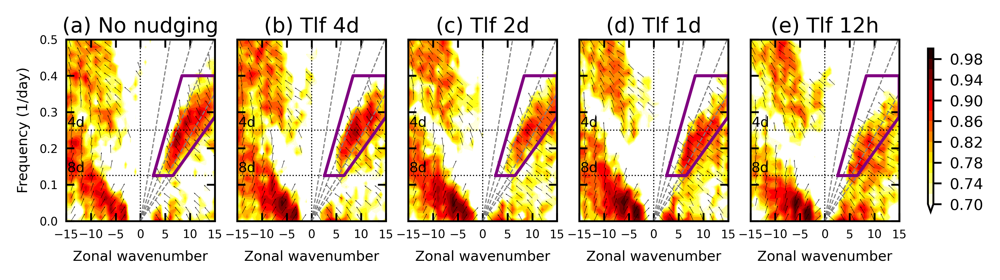

In [8]:
#########################################################
# Fig. 6: Coherence squared in wavenumber-frequency space, plot qbl
##########################################################
vname = list(['PCQ1_PCQ2','pr_T','pr_q'])
axid = np.array([0,1,2,3,4]).astype('int')
xid = np.array([0,0,0,0,0]).astype('int')
yid = np.array([0,1,2,3,4]).astype('int')
plot_coh2 = 1 # or 1. If 0, plot sin; if 1, plot coh2
extend_list = list(['min','both','both'])

for iplt in range(0,1):#3):#np.size(vname)):# plot coh^2 between PCQ1 and PCQ2   
    
    if plot_coh2==1:
        if iplt !=0:
            figname = 'fig6_coh2_'+vname[iplt]+'_'+str(plev_goal)+'.png'
        else:
            figname = 'fig6_coh2_'+vname[iplt]+'.png'

        v_cf = globals() ['coh_'+vname[iplt]+'_all']
        v_sin = globals() ['sin_'+vname[iplt]+'_all']
        v_cos = globals() ['cos_'+vname[iplt]+'_all']

        if iplt == 0:
            coh_min = 0.7
            cint = 0.02
            clev = np.arange(coh_min,1,cint)
            ticks = np.arange(coh_min,1,cint*2)  
        elif iplt == 1:
            coh_min = 0.4
            cint = 0.05
            clev = np.arange(coh_min,1+cint,cint)
            ticks = np.arange(coh_min,1+cint*2,cint*2) 
        elif iplt == 2:
            coh_min = 0.1
            cint = 0.05
            clev = np.arange(coh_min,0.8+cint,cint)
            ticks = np.arange(coh_min,0.8+cint*2,cint*2) 

        v_sin_new = np.where(v_cf>=coh_min, v_sin, np.nan)
        v_cos_new = np.where(v_cf>=coh_min, v_cos, np.nan) 

    fig,ax = plt.subplots(1,5,figsize=(6.5, 1.6),dpi=600)
    plt.subplots_adjust(left=0.1,right=0.98,top=0.9,bottom=0.22,wspace=0.15)
    plt.rcParams.update({'font.size': 5.5})
    for v in range(0,5):

        ax[yid[v]] = plt.subplot(1,n_nudge,axid[v]+1)
            
        # plot coh2 and sin, cos
        if plot_coh2 == 1:
            cf = plt.contourf(x, y, v_cf[:,:,v], cmap='hot_r', levels = clev, extend=extend_list[iplt]) 
        else:
            #cf = plt.contourf(x, y, v_cf[:,:,v], cmap=get_cmap(RWB), levels = clev, extend='neither') 
            cf = plt.contourf(x, y, v_cf[:,:,v], cmap='RdBu_r', levels = clev, extend='neither')
        
        # Mark 3, 6, 20 day period:
        for dd in range(0,np.size(d)):
            plt.plot([-15,15], [1/d[dd],1/d[dd]], 'k',linewidth=0.5, linestyle=':')#'dashed')
            plt.text(-14.8,1/d[dd]+0.01,dname[dd], fontsize=6)
        # Mark CCKW dispersion relationship:
        for hh in range(0,np.size(he_all)):
            plt.plot([0,zwnum_goal[hh]],[0,0.5],'grey',linewidth=0.5,linestyle='dashed')#,linestyle='dashed')#linestyle=':')#linestyle=(0,(5,5)))            
        # Mark zwnum == 0:
        plt.plot([0,0],[0,0.5],'k',linewidth=0.5,linestyle=':')#'dashed')
        # Mark CCKW band:
        # y=s*x
        for kk in range(0,np.size(kw_x)):
            plt.plot(kw_x,kw_y,'purple',linewidth=1.2,linestyle='solid')
        
        plt.title(title_short[v], pad=3, loc='center',fontsize=9)
        if v == 0:
            plt.ylabel('Frequency (1/day)',fontsize=6)
        plt.xlabel('Zonal wavenumber',fontsize=6)
        plt.axis([-15,15,0,0.5])
        plt.xticks([-15,-10,-5,0,5,10,15],fontsize=5)
        plt.yticks(np.arange(0,0.6,0.1),fontsize=5)
        plt.tick_params(bottom=True,top=True,left=True,right=True)
        if v == 0:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=True,labelright=False)
        else:
            plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)
        plt.tick_params(direction="in")

        if plot_coh2==1:
            plt.quiver(zwnum[::2],freq[::2],v_sin_new[::2,::2,v],v_cos_new[::2,::2,v],units='inches',scale=20)
        
    cb = fig.colorbar(cf,ax=ax[:],orientation = 'vertical',shrink=.9,\
                    fraction=0.1, aspect=30, pad=0.03)
    cb.ax.tick_params(labelsize=6.5)
    cb.set_ticks(ticks)  
    plt.savefig(figdir_all+figname,format='png', dpi=600)
    plt.show()
    plt.close()                                

EAPE gr1: [-4.59929228 -4.40189804 -4.13232287 -4.02218559 -4.00264429]
EAPE gr2: [3.40672768 3.15579363 2.90005933 2.84551731 2.61159157]


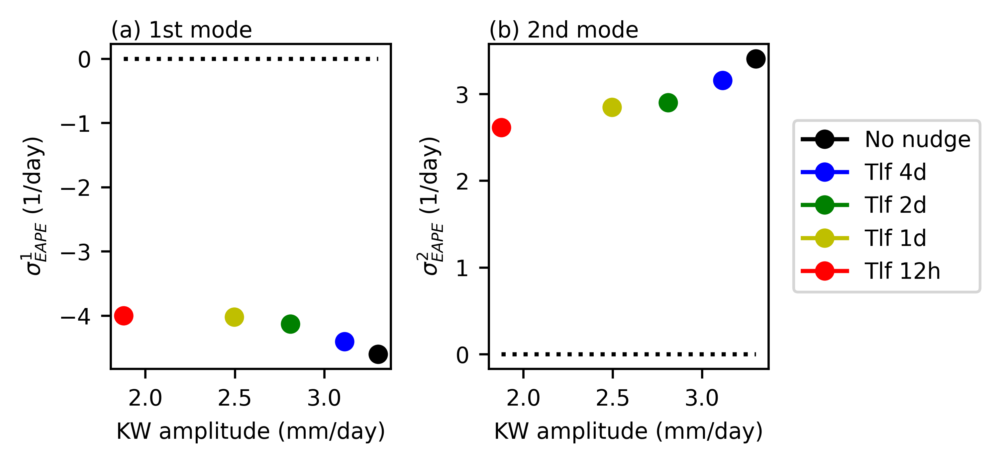

In [16]:
############################################
# Plot EAPE growth rate and amplitude
##############################################
calc_EAPEGR = 1
if calc_EAPEGR == 1:
    for inug in range(0,n_nudge):
        
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
    
        # lOAD KW COMPOSITE QT
        data  = np.load(output_dir+'QTUVZq_kw.npz')
        phase = data['phase']
        Q_KW  = data['Q_KW']
        T_KW  = data['T_KW']
        
        # lOAD EOF
        data = np.load(output_dir+'EOF.npz')
        EOF1 = data['R_EOF1_smooth']
        EOF2 = data['R_EOF2_smooth']
        plev = data['plev']
        nlev = np.size(plev)
    
        PCT1_KW = np.inner(T_KW[:,:], EOF1)
        PCQ1_KW = np.inner(Q_KW[:,:], EOF1)
        PCT2_KW = np.inner(T_KW[:,:], EOF2)
        PCQ2_KW = np.inner(Q_KW[:,:], EOF2)
        
        np.savez(output_dir+'kw_composite_PC1_PC2.npz', PCQ1_KW=PCQ1_KW, PCQ2_KW=PCQ2_KW,\
                 PCT1_KW=PCT1_KW, PCT2_KW=PCT2_KW, phase=phase)
    
        if inug == 0:
            EAPE_GR1_all  = np.empty([n_nudge])
            EAPE_GR2_all  = np.empty([n_nudge])
        EAPE_GR1_all[inug] = 2*np.mean(PCQ1_KW[:]*PCT1_KW[:],0)/np.mean(PCT1_KW[:]**2,0)*s2d
        EAPE_GR2_all[inug] = 2*np.mean(PCQ2_KW[:]*PCT2_KW[:],0)/np.mean(PCT2_KW[:]**2,0)*s2d
        
    np.savez(output_dir_all+'EAPE_growth_rate.npz',EAPE_GR1_all=EAPE_GR1_all, EAPE_GR2_all=EAPE_GR2_all)
else:
    data = np.load(output_dir_all+'EAPE_growth_rate.npz')
    EAPE_GR1_all = data['EAPE_GR1_all']
    EAPE_GR2_all = data['EAPE_GR2_all']
    
print('EAPE gr1:',EAPE_GR1_all)
print('EAPE gr2:',EAPE_GR2_all)

#############################
# Plot growth rate and KW amplitude
figname = 'fig7_EAPEGR_KWamp_scatter.png'
fig,ax = plt.subplots(1,2,figsize=(5.5, 2.4),dpi=600)
plt.subplots_adjust(left=0.1,right=0.7,top=0.9,bottom=0.22,wspace=0.35)
plt.rcParams.update({'font.size': 7.5})
zero = np.array([0,0])
kw_amp_test = np.array([np.min(kw_amp_all), np.max(kw_amp_all)])
plt.subplot(1,2,1)
for inug in range(0, n_nudge):    
    plt.plot(kw_amp_all[inug], EAPE_GR1_all[inug], color=color[inug], marker = 'o') 
plt.title('(a) 1st mode', pad=2.5, loc='left',fontsize=8)
plt.xlabel('KW amplitude (mm/day)',fontsize=8)
plt.ylabel('$\u03C3^{\t{1}}_{\t{EAPE}}$ (1/day)',fontsize=8) 
plt.plot(kw_amp_test, zero, 'k:')
#
plt.subplot(1,2,2)
plt.title('(b) 2nd mode', pad=2.5, loc='left',fontsize=8)
for inug in range(0, n_nudge):    
    plt.plot(kw_amp_all[inug], EAPE_GR2_all[inug], color=color[inug], marker = 'o') 
ax = plt.gca()
legend = ax.legend(legend_list, bbox_to_anchor=(1.05, 0.5), loc='center left',fontsize=8)
plt.xlabel('KW amplitude (mm/day)',fontsize=8)
plt.ylabel('$\u03C3^{\t{2}}_{\t{EAPE}}$ (1/day)',fontsize=8) 

plt.plot(kw_amp_test, zero, 'k:')
#plt.legend(legend_list)
plt.savefig(figdir_all+figname,format='png', dpi=600)
plt.show()
plt.close()    

In [ ]:
##########################
# Check Q-T relationship
########################
for inug in range(0,n_nudge):

    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'
    
    data = np.load(output_dir+'kw_composite_PC1_PC2.npz')
    phase   = data['phase']
    nphase  = np.size(phase)
    if inug == 0:
        PCQ1_KW_all = np.empty([nphase, n_nudge])
        PCQ2_KW_all = np.empty([nphase, n_nudge])
        PCT1_KW_all = np.empty([nphase, n_nudge])
        PCT2_KW_all = np.empty([nphase, n_nudge])
        
    PCQ1_KW_all[:,inug] = data['PCQ1_KW']
    PCQ2_KW_all[:,inug] = data['PCQ2_KW']
    PCT1_KW_all[:,inug] = data['PCT1_KW']
    PCT2_KW_all[:,inug] = data['PCT2_KW']
    

# Load KW amplitude
data = np.load(output_dir_all+'kw_pr_amplitude.npz')
kw_amp_all = data['kw_amp_all']
print(kw_amp_all)

PCQ1_KW_all = PCQ1_KW_all/kw_amp_all*s2d
PCQ2_KW_all = PCQ2_KW_all/kw_amp_all*s2d
PCT1_KW_all = PCT1_KW_all/kw_amp_all
PCT2_KW_all = PCT2_KW_all/kw_amp_all

# Plot KW compoiste qlf and qbl
nph = np.size(phase)
zero = np.zeros([nph])
fig_name = 'fig9_KW_Q12_T12.png'
fig = plt.subplots(2,1,figsize=(5.5, 5),dpi=600)
plt.subplots_adjust(left=0.2,right=0.8,top=0.9,bottom=0.2, hspace=0.4)
plt.rcParams.update({'font.size': 9})
plt.subplot(2,1,1)
plt.title('(a) 1st mode', pad=2.5, loc='left',fontsize=10)
plt.plot(phase, PCQ1_KW_all[:,0],color='k',marker='o',markersize=5)
plt.plot(phase, PCQ1_KW_all[:,1],color='b',marker='o',markersize=5)
plt.plot(phase, PCQ1_KW_all[:,2],color='g',marker='o',markersize=5)
plt.plot(phase, PCQ1_KW_all[:,3],color='y',marker='o',markersize=5)
plt.plot(phase, PCQ1_KW_all[:,4],color='r',marker='o',markersize=5)
plt.plot(phase, zero,'k--')
ax = plt.gca()
ax.legend(legend_list, bbox_to_anchor=(1, 1), loc='upper left',fontsize=7)
plt.plot(phase, PCT1_KW_all[:,0],color='k',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT1_KW_all[:,1],color='b',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT1_KW_all[:,2],color='g',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT1_KW_all[:,3],color='y',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT1_KW_all[:,4],color='r',marker='x',markersize=5, linestyle='dashed')
plt.xticks(bin_simple,(PI,'3'+PI+'/4',PI+'/2',PI+'/4','0','-'+PI+'/4','-'+PI+'/2','-3'+PI+'/4','-'+PI))
plt.xlabel('KW Phase')
plt.ylabel('Q1 or T1 ${(mm/day)}^{-1}$')

plt.subplot(2,1,2)
plt.title('(b) 2nd mode', pad=2.5, loc='left',fontsize=10)
plt.plot(phase, PCQ2_KW_all[:,0],color='k',marker='o',markersize=5)
plt.plot(phase, PCQ2_KW_all[:,1],color='b',marker='o',markersize=5)
plt.plot(phase, PCQ2_KW_all[:,2],color='g',marker='o',markersize=5)
plt.plot(phase, PCQ2_KW_all[:,3],color='y',marker='o',markersize=5)
plt.plot(phase, PCQ2_KW_all[:,4],color='r',marker='o',markersize=5)
plt.plot(phase, zero,'k--')
#ax = plt.gca()
#ax.legend(legend_list, bbox_to_anchor=(1, 1), loc='upper left',fontsize=7)
plt.plot(phase, PCT2_KW_all[:,0],color='k',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT2_KW_all[:,1],color='b',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT2_KW_all[:,2],color='g',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT2_KW_all[:,3],color='y',marker='x',markersize=5, linestyle='dashed')
plt.plot(phase, PCT2_KW_all[:,4],color='r',marker='x',markersize=5, linestyle='dashed')
plt.xticks(bin_simple,(PI,'3'+PI+'/4',PI+'/2',PI+'/4','0','-'+PI+'/4','-'+PI+'/2','-3'+PI+'/4','-'+PI))
plt.xlabel('KW Phase')
plt.ylabel('Q2 or T2 ${(mm/day)}^{-1}$')
#plt.ylabel('Q2 or T2 (${mm/day})^{-1}$')
#plt.yticks(np.arange(-4,5,1))
plt.savefig(figdir_all+fig_name,format='png', dpi=600)
plt.show()
plt.close()

[3.30064838 3.11443936 2.80990316 2.49600268 1.877877  ]


In [ ]:
##########################
# KW composite Q2 and q
########################


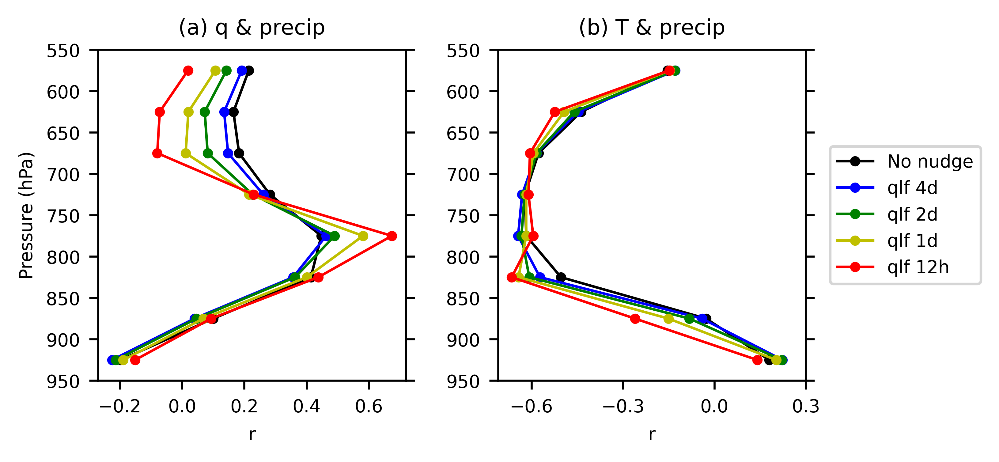

In [17]:
#####################################
# Moisture analysis 1: correlation coefficient between moisture and precip
########################################
for inug in range(0,n_nudge):

    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'
    #print(CASENAME)
    
    data = np.load(output_dir+'corrcoef_qv_T_pr_level.npz')
    plev_new = data['plev']
    nlev_new = np.size(plev_new)
    if inug == 0:
        r_qv_all = np.empty([nlev_new, n_nudge])
        r_qv_below_500 = np.empty([nlev_new, n_nudge])
        r_T_all = np.empty([nlev_new, n_nudge])
        r_T_below_500 = np.empty([nlev_new, n_nudge])
        
    r_qv_all[:,inug] = data['r_qv_pr']
    r_qv_below_500[:,inug] = np.where(plev_new<550, np.nan, r_qv_all[:,inug])

    r_T_all[:,inug] = data['r_T_pr']
    r_T_below_500[:,inug] = np.where(plev_new<550, np.nan, r_T_all[:,inug])

r_vname_list = list(['r_qv_below_500','r_T_below_500'])
# Plot correlation coefficient
font = 7
fig,axes = plt.subplots(1,2,figsize=(5.5, 2.4),dpi=600)
plt.subplots_adjust(left=0.1,right=0.8,top=0.9,bottom=0.15,wspace=0.3)
plt.rcParams.update({'font.size': font})
for iplt in range(0, 2):
    plt.subplot(1,2,iplt+1)
    V = globals()[r_vname_list[iplt]]
    plt.plot(V[:,0], plev_new, color=color[0], marker='o', markersize=3, linewidth=1)
    plt.plot(V[:,1], plev_new, color=color[1], marker='o', markersize=3, linewidth=1)
    plt.plot(V[:,2], plev_new, color=color[2], marker='o', markersize=3, linewidth=1)
    plt.plot(V[:,3], plev_new, color=color[3], marker='o', markersize=3, linewidth=1)
    plt.plot(V[:,4], plev_new, color=color[4], marker='o', markersize=3, linewidth=1)
    plt.ylim([550,np.max(plev_new)])
    plt.yticks( np.arange(550, 1000, 50) )
    plt.tick_params(bottom=True,top=False,left=True,right=True)
    plt.tick_params(labelbottom=True,labeltop=False,labelleft=True,labelright=False)
    plt.gca().invert_yaxis()
    plt.xlabel('r')
    if iplt == 0:
        plt.title('(a) q & precip')
        plt.ylabel('Pressure (hPa)')
    else:
        plt.title('(b) T & precip')
        plt.xticks(np.arange(-0.6,0.6,0.3))
    ax = plt.gca()
    if iplt == 1:
        legend = ax.legend(legend_list, bbox_to_anchor=(1.05, 0.5), loc='center left',fontsize=font)
plt.savefig(figdir_all+'fig10_corrcoef_q_T_pr_level.png',dpi=600)
plt.show()

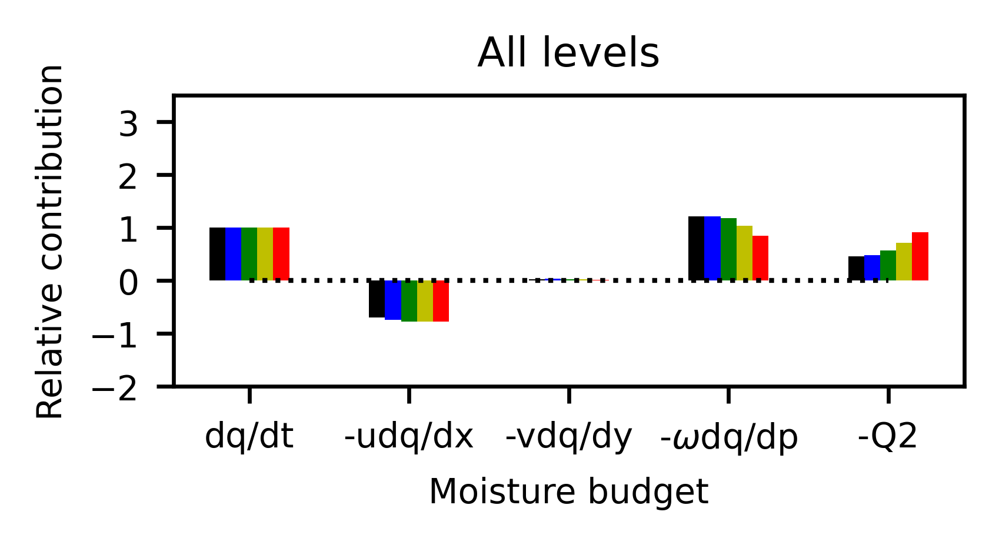

In [ ]:
#####################################
# Moisture analysis 2: contribution from each budget term
########################################
calc_dqdt_contribution = 1

if calc_dqdt_contribution == 1:
    
    for inug in range(0, n_nudge):

        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
        
        data     = np.load(output_dir+'dqdt_udqdx_vdqdy_wdqdp_Q2_kwcomposite.npz')
        dqdt_KW  = data['dqdt_KW']
        udqdx_KW = data['udqdx_KW']
        vdqdy_KW = data['vdqdy_KW']
        wdqdp_KW = data['wdqdp_KW']
        Q2_KW    = data['Q2_KW']
        plev_KW  = data['plev']
        phase    = data['phase']
    
        nlev_KW = np.size(plev_KW)
        budget_list = list(['dqdt_dqdt','udqdx_dqdt','vdqdy_dqdt','wdqdp_dqdt','Q2_dqdt'])
        if inug == 0:
            r_all_level = np.empty([6, n_nudge])
            r_750_850   = np.empty([6, n_nudge])
            r_850_950   = np.empty([6, n_nudge])
        # contributino to dqdt
        for i in range(0,3): # or 4
            
            if i==0: # All levels
                ilev_min = 0
                ilev_max = nlev_KW
            elif i==1: # Lower free troposphere (750-850 hPa)
                ilev_min = np.argwhere(plev_KW==750).squeeze()
                ilev_max = np.argwhere(plev_KW==850).squeeze()
            elif i == 2: # Boundary layer (850- 950 hPa)
                ilev_min = np.argwhere(plev_KW==850).squeeze()
                ilev_max = np.argwhere(plev_KW==950).squeeze()
            elif i == 3:
                ilev_min = np.argwhere(plev_KW==450).squeeze()
                ilev_max = np.argwhere(plev_KW==650).squeeze()
            
            r_dqdt  = np.sum(dqdt_KW[:,ilev_min:ilev_max+1]*dqdt_KW[:,ilev_min:ilev_max+1])/np.sum(dqdt_KW[:,ilev_min:ilev_max+1]**2)
            r_udqdx = np.sum(dqdt_KW[:,ilev_min:ilev_max+1]*(-udqdx_KW[:,ilev_min:ilev_max+1]))/np.sum(dqdt_KW[:,ilev_min:ilev_max+1]**2)
            r_vdqdy = np.sum(dqdt_KW[:,ilev_min:ilev_max+1]*(-vdqdy_KW[:,ilev_min:ilev_max+1]))/np.sum(dqdt_KW[:,ilev_min:ilev_max+1]**2)
            r_wdqdp = np.sum(dqdt_KW[:,ilev_min:ilev_max+1]*(-wdqdp_KW[:,ilev_min:ilev_max+1]))/np.sum(dqdt_KW[:,ilev_min:ilev_max+1]**2)
            r_Q2    = np.sum(dqdt_KW[:,ilev_min:ilev_max+1]*(-Q2_KW[:,ilev_min:ilev_max+1]))/np.sum(dqdt_KW[:,ilev_min:ilev_max+1]**2)
            r_res   = 1-r_udqdx-r_vdqdy-r_wdqdp-r_Q2
            if i == 0:
                r_all_level[:,inug] = np.array([r_dqdt, r_udqdx, r_vdqdy, r_wdqdp, r_Q2, r_res])
            elif i == 1:
                r_750_850[:,inug] = np.array([r_dqdt, r_udqdx, r_vdqdy, r_wdqdp, r_Q2, r_res])
            elif i == 2:
                r_850_950[:,inug] = np.array([r_dqdt, r_udqdx, r_vdqdy, r_wdqdp, r_Q2, r_res])
    np.savez(output_dir_all+'kwcomposite_qbudget_each_term_contribution_to_dqdt.npz', r_all_level=r_all_level, r_750_850=r_750_850, r_850_950=r_850_950, \
             budget_list=budget_list, plev_KW=plev_KW)
else:
    data = np.load(output_dir_all+'kwcomposite_qbudget_each_term_contribution_to_dqdt.npz')
    r_all_level = data['r_all_level']
    r_750_850   = data['r_750_850']
    r_850_950   = data['r_850_950']

##############################
# Plot bar plot for q at 750-850 and 850-950 hPa
####################################
vname_list = list(['r_all_level','r_750_850','r_850_950'])
title_list = list(['All levels','Lower free troposphere (750-850 hPa)','Boundary layer (850-950 hPa)','Mid troposphere (450-650 hPa)'])
figname_list = list(['all_level','750_850','850_950','450_650'])
dx_list = np.arange(-2,3,1)
for i in range(0,3):
    font = 7
    # Plot bar plot of relative contribution of each buget term
    fig,axes = plt.subplots(1,1,figsize=(3.2, 1.5),dpi=600)
    ax = plt.gca()
    plt.subplots_adjust(left=0.2,right=0.9,top=0.8,bottom=0.25)
    plt.rcParams.update({'font.size': font})
    x = np.arange(0,50, 10)
    zero = np.zeros([np.size(x)])
    V = globals()[vname_list[i]]
    for inug in range(0,n_nudge):
        x_new = x + dx_list[inug]
        plt.bar(x_new, V[:-1,inug], color=color[inug], width=1)
    plt.plot(x, zero, 'k:', linewidth=1)
    plt.xticks(x,('dq/dt','-udq/dx','-vdq/dy','-$\omega$dq/dp','-Q2'))
    plt.xlabel('Moisture budget')
    plt.ylabel('Relative contribution')
    plt.title(title_list[i])
    if i == 0 or i == 1:
        plt.ylim([-1.5,3.5])
        plt.yticks(np.arange(-2,4,1))
        #plt.yticks(np.arange(-1,4,1))
        #plt.ylim([-1,3])
    elif i == 2:
        plt.ylim([-1.5,3.5])
        plt.yticks(np.arange(-2,4,1))
    elif i == 3:
        plt.ylim([-2,4])
        plt.yticks(np.arange(-2,6,2))        
    plt.savefig(figdir_all+'fig11_dqdt_contribution_'+figname_list[i]+'.png',dpi=600)
    plt.show()

[3.30064838 3.09723552 2.77802849 2.50033525 1.8546236 ]


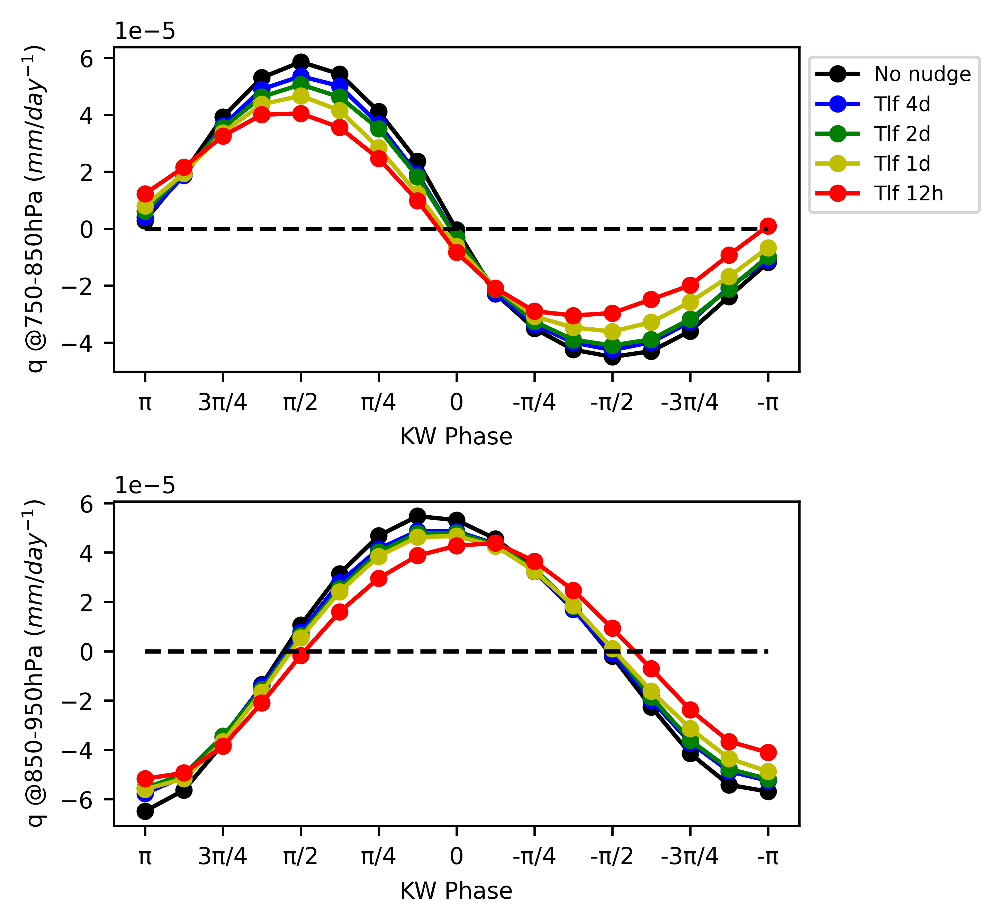

In [45]:
###################################
# Quantify q for boundary layer and lower free troposphere
####################################
data     = np.load(output_dir_all+'QTUVZq_kw.npz')
q_KW_all = data['q_KW_all'][:,:,:] #(phase, nlev, n_nudge) #Q,T,U,Z,W,V
plev     = data['plev']
phase    = data['phase']

# Lower free troposphere
ilev_min_lf = np.argwhere(plev==750).squeeze()
ilev_max_lf = np.argwhere(plev==850).squeeze()

# Boundary layer
ilev_min_bl = np.argwhere(plev==850).squeeze()
ilev_max_bl = np.argwhere(plev==950).squeeze()

qlf_KW_all = np.mean(q_KW_all[:, ilev_min_lf:ilev_max_lf+1, :], 1)
qbl_KW_all = np.mean(q_KW_all[:, ilev_min_bl:ilev_max_bl+1, :], 1)

# Load KW amplitude
data = np.load(output_dir_all+'kw_pr_amplitude.npz')
kw_amp_all = data['kw_amp_all']
print(kw_amp_all)

normalize_by_kwamp = 1
if normalize_by_kwamp == 1:
    qlf_KW_all = qlf_KW_all/kw_amp_all
    qbl_KW_all = qbl_KW_all/kw_amp_all

# Plot KW compoiste qlf and qbl
nph = np.size(phase)
zero = np.zeros([nph])
fig_name = 'fig12_KW_qlf_qbl_1cyc.png'
fig = plt.subplots(2,1,figsize=(5.5, 5),dpi=600)
plt.subplots_adjust(left=0.2,right=0.8,top=0.95,bottom=0.2, hspace=0.4)
plt.rcParams.update({'font.size': 8})
plt.subplot(2,1,1)
plt.plot(phase, qlf_KW_all[:,0],color='k',marker='o',markersize=5)
plt.plot(phase, qlf_KW_all[:,1],color='b',marker='o',markersize=5)
plt.plot(phase, qlf_KW_all[:,2],color='g',marker='o',markersize=5)
plt.plot(phase, qlf_KW_all[:,3],color='y',marker='o',markersize=5)
plt.plot(phase, qlf_KW_all[:,4],color='r',marker='o',markersize=5)
plt.plot(phase, zero,'k--')
ax = plt.gca()
ax.legend(legend_list, bbox_to_anchor=(1, 1), loc='upper left',fontsize=7)
plt.xticks(bin_simple,(PI,'3'+PI+'/4',PI+'/2',PI+'/4','0','-'+PI+'/4','-'+PI+'/2','-3'+PI+'/4','-'+PI))
plt.xlabel('KW Phase')
plt.ylabel('q @750-850hPa (${mm/day}^{-1}$)')
#plt.yticks(np.arange(-3,4,1))
#
plt.subplot(2,1,2)
plt.plot(phase, qbl_KW_all[:,0],color='k',marker='o',markersize=5)
plt.plot(phase, qbl_KW_all[:,1],color='b',marker='o',markersize=5)
plt.plot(phase, qbl_KW_all[:,2],color='g',marker='o',markersize=5)
plt.plot(phase, qbl_KW_all[:,3],color='y',marker='o',markersize=5)
plt.plot(phase, qbl_KW_all[:,4],color='r',marker='o',markersize=5)
plt.plot(phase, zero,'k--')
ax = plt.gca()
#ax.legend(legend_list, bbox_to_anchor=(1, 1), loc='upper left',fontsize=7)
plt.xticks(bin_simple,(PI,'3'+PI+'/4',PI+'/2',PI+'/4','0','-'+PI+'/4','-'+PI+'/2','-3'+PI+'/4','-'+PI))
plt.xlabel('KW Phase')
plt.ylabel('q @850-950hPa (${mm/day}^{-1}$)')
#plt.yticks(np.arange(-4,5,1))
plt.savefig(figdir_all+fig_name,format='png', dpi=600)
plt.show()
plt.close()

[3.30064838 3.09723552 2.77802849 2.50033525 1.8546236 ]


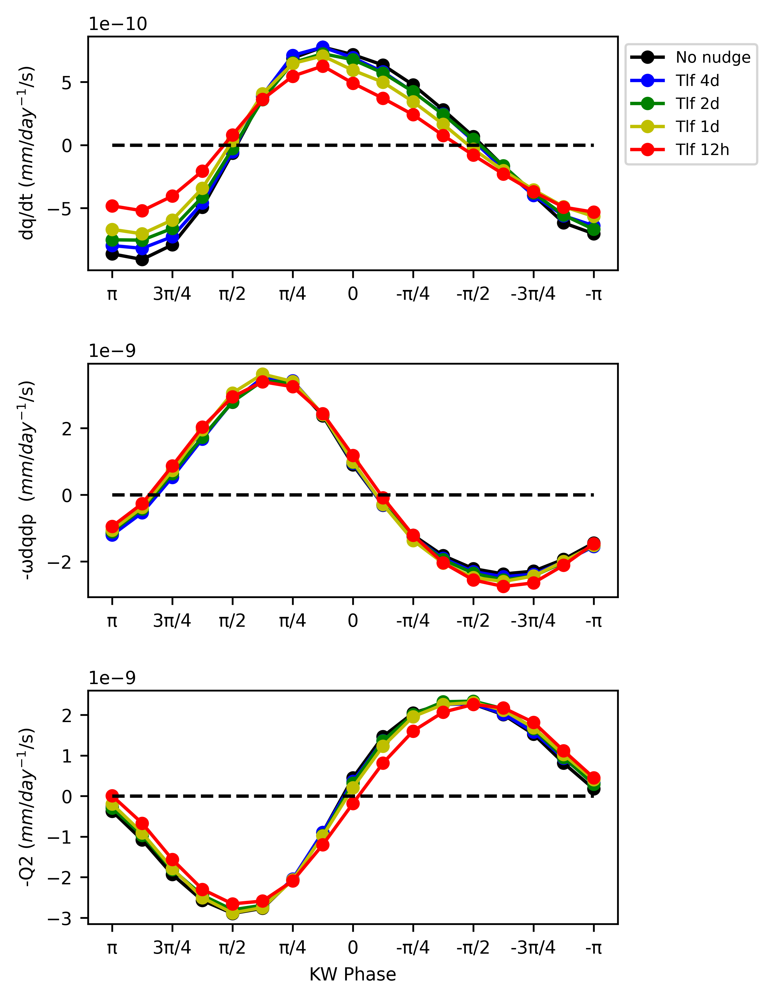

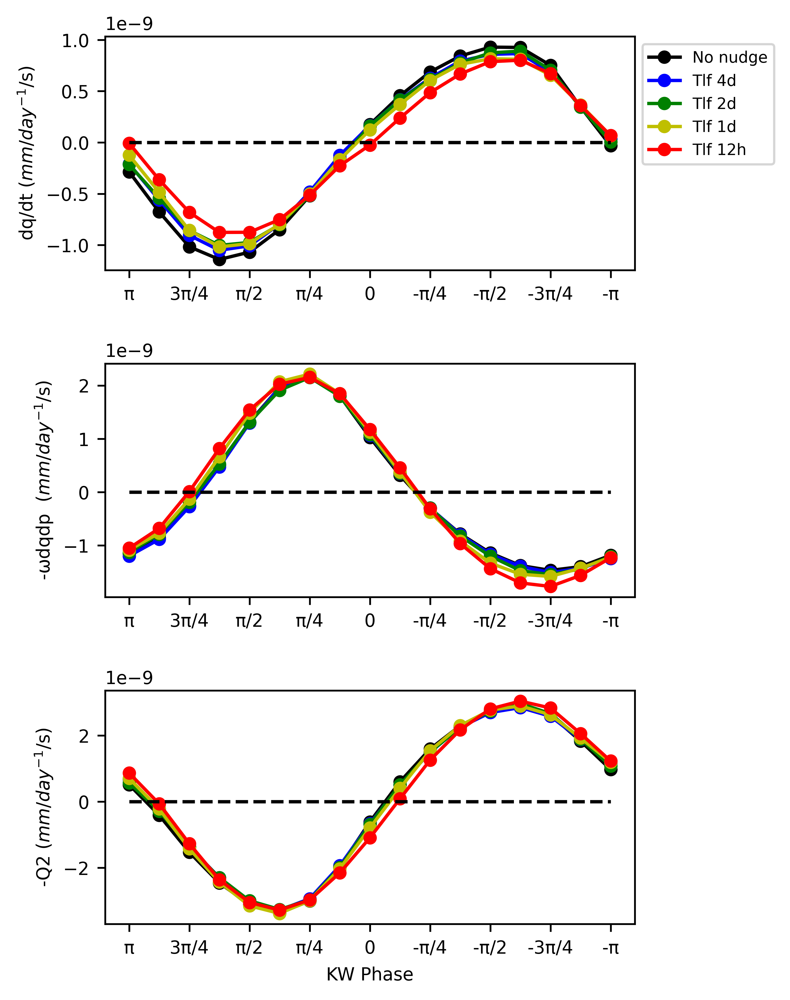

In [52]:
###################################
# Quantify q budget for boundary layer and lower free troposphere
####################################
# Combine KW composite dqdt term
combine_kw_dqdt = 1

if combine_kw_dqdt == 1:
    for inug in range(0,n_nudge):
        
        CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
        output_dir = dir_out+'output_data/'+CASENAME+'/'
    
        data     = np.load(output_dir+'dqdt_udqdx_vdqdy_wdqdp_Q2_kwcomposite.npz')
        plev_KW  = data['plev']
        nlev_KW  = np.size(plev_KW)
        phase    = data['phase']
        nphase   = np.size(phase)
    
        # Lower free troposphere
        ilev_min_lf = np.argwhere(plev_KW==750).squeeze()
        ilev_max_lf = np.argwhere(plev_KW==850).squeeze()
        
        # Boundary layer
        ilev_min_bl = np.argwhere(plev_KW==850).squeeze()
        ilev_max_bl = np.argwhere(plev_KW==950).squeeze()
    
        if inug == 0:
            dqdt_lf_KW_all  = np.empty([nphase, n_nudge])
            wdqdp_lf_KW_all = np.empty([nphase, n_nudge])
            Q2_lf_KW_all    = np.empty([nphase, n_nudge])
            dqdt_bl_KW_all  = np.empty([nphase, n_nudge])
            wdqdp_bl_KW_all = np.empty([nphase, n_nudge])
            Q2_bl_KW_all    = np.empty([nphase, n_nudge])
            
        dqdt_lf_KW_all[:,inug]   = np.mean( data['dqdt_KW'][:,ilev_min_lf:ilev_max_lf+1], 1)
        wdqdp_lf_KW_all[:,inug]  = np.mean( data['wdqdp_KW'][:,ilev_min_lf:ilev_max_lf+1], 1)
        Q2_lf_KW_all[:,inug]     = np.mean( data['Q2_KW'][:,ilev_min_lf:ilev_max_lf+1], 1)
        
        dqdt_bl_KW_all[:,inug]   = np.mean( data['dqdt_KW'][:,ilev_min_bl:ilev_max_bl+1], 1)
        wdqdp_bl_KW_all[:,inug]  = np.mean( data['wdqdp_KW'][:,ilev_min_bl:ilev_max_bl+1], 1)
        Q2_bl_KW_all[:,inug]     = np.mean( data['Q2_KW'][:,ilev_min_bl:ilev_max_bl+1], 1)
    
    
    np.savez(output_dir_all+'kwcomposite_qbudget_each_term.npz', dqdt_lf_KW_all=dqdt_lf_KW_all, wdqdp_lf_KW_all=wdqdp_lf_KW_all, Q2_lf_KW_all=Q2_lf_KW_all,\
            dqdt_bl_KW_all=dqdt_bl_KW_all, wdqdp_bl_KW_all=wdqdp_bl_KW_all, Q2_bl_KW_all=Q2_bl_KW_all, phase=phase)

else:
    # Load each term
    data = np.load(output_dir_all+'kwcomposite_qbudget_each_term.npz')
    dqdt_lf_KW_all  = data['dqdt_lf_KW_all']
    wdqdp_lf_KW_all = data['wdqdp_lf_KW_all']
    Q2_lf_KW_all    = data['Q2_lf_KW_all']
    #
    dqdt_bl_KW_all  = data['dqdt_bl_KW_all']
    wdqdp_bl_KW_all = data['wdqdp_bl_KW_all']
    Q2_bl_KW_all    = data['Q2_bl_KW_all']

# Load KW amplitude
data = np.load(output_dir_all+'kw_pr_amplitude.npz')
kw_amp_all = data['kw_amp_all']
print(kw_amp_all)

normalize_by_kwamp = 1
if normalize_by_kwamp == 1:
    #
    dqdt_lf_KW_all  = dqdt_lf_KW_all/kw_amp_all
    wdqdp_lf_KW_all = wdqdp_lf_KW_all/kw_amp_all
    Q2_lf_KW_all    = Q2_lf_KW_all/kw_amp_all
    #
    dqdt_bl_KW_all  = dqdt_bl_KW_all/kw_amp_all
    wdqdp_bl_KW_all = wdqdp_bl_KW_all/kw_amp_all
    Q2_bl_KW_all    = Q2_bl_KW_all/kw_amp_all

# PLot figure
nph = np.size(phase)
zero = np.zeros([nph])
vname_list = list(['lf','bl'])
row_list = list(['dqdt','wdqdp','Q2'])
rowname_list = list(['dq/dt','-\u03C9dqdp ','-Q2'])
for iplt in range(0,2):
    fig_name = 'fig13_KW_dqdt_'+vname_list[iplt]+'.png'
    fig = plt.subplots(3,1,figsize=(5.5, 6.5),dpi=600)
    plt.subplots_adjust(left=0.2,right=0.8,top=0.95,bottom=0.1, hspace=0.4)
    plt.rcParams.update({'font.size': 8})
    for irow in range(0,3):
        plt.subplot(3,1,irow+1)
        V = globals()[row_list[irow]+'_'+vname_list[iplt]+'_KW_all']
        if irow !=0:
            V = -V
        plt.plot(phase, V[:,0],color='k',marker='o',markersize=5)
        plt.plot(phase, V[:,1],color='b',marker='o',markersize=5)
        plt.plot(phase, V[:,2],color='g',marker='o',markersize=5)
        plt.plot(phase, V[:,3],color='y',marker='o',markersize=5)
        plt.plot(phase, V[:,4],color='r',marker='o',markersize=5)
        plt.plot(phase, zero,'k--')
        plt.xticks(bin_simple,(PI,'3'+PI+'/4',PI+'/2',PI+'/4','0','-'+PI+'/4','-'+PI+'/2','-3'+PI+'/4','-'+PI))
        plt.ylabel(rowname_list[irow]+' (${mm/day}^{-1}$/s)')
        ax = plt.gca()
        if irow == 0:
            ax.legend(legend_list, bbox_to_anchor=(1, 1), loc='upper left',fontsize=7)
        elif irow == 2:
            plt.xlabel('KW Phase')
    plt.savefig(figdir_all+fig_name,format='png', dpi=600)
    plt.show()
    plt.close()

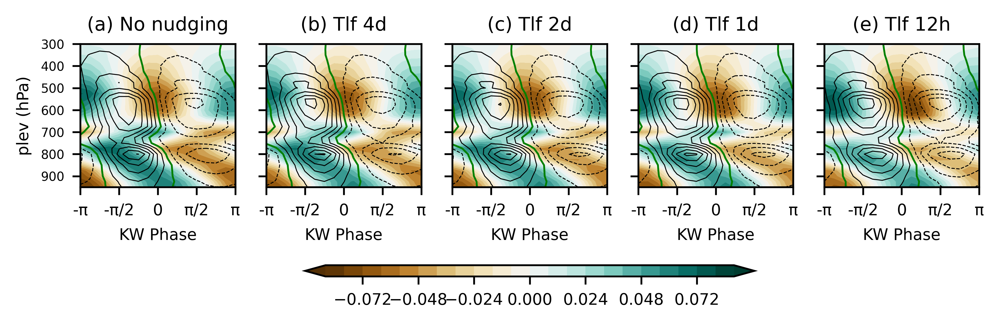

In [80]:
############################
# KW composite Q2 and q / wdqdp and q
############################
for inug in range(0,n_nudge):
    
    CASENAME   = CASENAME_LIST2[icase]+'_'+NUDGE_LIST[inug]
    output_dir = dir_out+'output_data/'+CASENAME+'/'
    data       = np.load(output_dir+'dqdt_udqdx_vdqdy_wdqdp_Q2_kwcomposite.npz')
    plev       = data['plev']
    nlev       = np.size(plev)
    phase      = data['phase']
    nphase     = np.size(phase)
    if inug == 0:
        Q2_KW_all = np.empty([nphase, nlev, n_nudge])
        wdqdp_KW_all = np.empty([nphase, nlev, n_nudge])
        q_KW_all  = np.empty([nphase, nlev, n_nudge])
    Q2_KW_all[:,:,inug] = data['Q2_KW']
    wdqdp_KW_all[:,:,inug] = data['wdqdp_KW']

    
    data = np.load(output_dir+'QTUVZq_kw.npz')    
    q_KW_all[:,:,inug]  = data['q_KW'][:,1:-2]

# Load KW amplitude
data = np.load(output_dir_all+'kw_pr_amplitude.npz')
phase     = data['phase']
kw_amp_all = data['kw_amp_all']

#####################################
# Plot figures
font = 7
fig,axes = plt.subplots(1,5,figsize=(6.5, 2),dpi=600)
plt.subplots_adjust(left=0.1,right=0.95,top=0.9,bottom=0.1,hspace=0.27)
plt.rcParams.update({'font.size': font})

normalize_by_kwpr = 1
# contour levels
if normalize_by_kwpr == 1:
    c = kw_amp_all
    const_clev = 2.5
else:
    c = 1
    const_clev = 1

# Change color level!
clev = np.arange(-0.22,0.24,0.02)/const_clev #q/const_clev
clev_p = np.arange(2,16,2)*10**(-9)/const_clev
clev_n = np.arange(-14,0,2)*10**(-9)/const_clev
clev_0 = 0

xx, yy = np.meshgrid(phase, plev1)

for inug in range(0,5):
    plt.subplot(1,5,inug+1)
    ax = plt.gca()
    VAR_cf = globals() ['q_KW_all']
    #VAR_cn = globals() ['Q2_KW_all'] # q budget total
    VAR_cn = globals() ['wdqdp_KW_all'] # q budget total
    VAR_cf = VAR_cf/c*1000
    VAR_cn = -VAR_cn/c
    cf   = plt.contourf(xx, yy, VAR_cf[:,:,inug].T, levels=clev, cmap='BrBG', extend='both' )
    cn_p = plt.contour(xx, yy, VAR_cn[:,:,inug].T, levels=clev_p, colors='k', linewidths=0.4)
    cn_0 = plt.contour(xx, yy, VAR_cn[:,:,inug].T, levels=clev_0, colors='g', linewidths=0.8)
    cn_n = plt.contour(xx, yy, VAR_cn[:,:,inug].T, levels=clev_n, colors='k', linestyles='dashed',linewidths=0.4)
    plt.ylim([300, np.max(plev_KW)])
    plt.title(title[inug])
    
    plt.gca().invert_yaxis()
    plt.xticks(np.arange(-pi,pi+pi/2,pi/2),('-'+PI,'-'+PI+'/2','0',PI+'/2',PI),fontsize=font)
    #ax.yaxis.set_label_position("right")
    plt.tick_params(bottom=True,top=False,left=True,right=False)
    plt.yticks(np.arange(300,1000,100))
    if inug == 0:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=True,labelright=False)
        ax.set_ylabel('plev (hPa)',fontsize=font)
        
    else:
        plt.tick_params(labelbottom=True,labeltop=False,labelleft=False,labelright=False)       

    plt.xlabel('KW Phase',fontsize=font)

cb = plt.colorbar(cf,ax=axes,orientation = 'horizontal', shrink=.5, aspect=40,pad=0.3) 

#plt.savefig(figdir_all+'fig12_q_Q2_KW.png',dpi=600)
plt.savefig(figdir_all+'fig12_q_wdqdp_KW.png',dpi=600)
plt.show()
plt.close()